In [1]:
import numpy as np
import glob
import re
import matplotlib.pyplot as plt
import sys
import seaborn as sns
import scanpy as sc
import pandas as pd
import os
from plotnine import * 

In [2]:
sys.path.insert(1, '/secure/projects/HTAPP_MBC/src/')

In [3]:
from init_phase2 import * 

In [33]:
res_dir=baseDir+"/analysis/01_annotation/"
os.makedirs(res_dir,exist_ok=True)

In [4]:
cacheName="fresh"

In [ ]:
de_dir=baseDir + "/differential_expression"
if not os.path.isdir(de_dir):
    os.mkdir(de_dir)

In [5]:
fpath=baseDir+"/analysis/00_stats/summary/sample_annot.tsv"
samples=pd.read_csv(fpath,"\t")
samples['raw_data'] =  dataDir+"/"+samples['sampleid']+"_10x"+"/"+samples['sampleName']+"/"+"cellbender_out_filtered.h5"
samples.head()

,ccpmID,orig.ident,sampleName,sampleid,Estimated Number of Cells,Mean Reads per Cell,Median Genes per Cell,Number of Reads,Fraction Reads in Cells,Sequencing Saturation,Reads Mapped Confidently to Genome,Reads Mapped Confidently to Transcriptome,Reads Mapped Antisense to Gene,condition,replicate,ccpm,date,Lane,Index,cancer,site,reference,flowcell,mode,mean_UMI,mean_genes,N_cells,mean_percent.mito,percent_epithelial,percent_chondrocyte,percent_epithelial_neuro,percent_epithelial_stem,percent_lymphocyte,percent_mono_macro,percent_fibroblast,percent_smooth_muscle,percent_endothelial,mean_doublet_score,percent_doublet,ccpm_id,ccpm_id_long,sample,fresh,frozen,stage_at_diagnosis,metastatic_presentation,biopsy_days_after_dob,biopsy_days_after_diagnosis,biopsy_days_after_metastasis,prior_lines_tx_metastatic,prior_lines_tx_total,ER_primary_fraction,ER_primary,ER_biopsy_fraction,ER_biopsy,ER_concordance,PR_primary_fraction,PR_primary,PR_biopsy_fraction,PR_biopsy,PR_concordance,HER2_primary,HER2_biopsy,HER2_concordance,receptors_primary,receptors_biopsy,site_biopsy,site_biopsy_detail,grade_breast,histology_breast,histology_breast2,histology_biopsy,inflammatory,raw_data
0,0200471T1,HTAPP-214-SMP-6753-TST-channel1,HTAPP-214-SMP-6753_TST_channel1,HTAPP-214-SMP-6753,433,162336,79,70291538,46.1,15.5,1.0,0.6,0.2,TST,channel1,0200471_T1_TST,2019_04_02,2,SI-GA-E1,breast,liver,GRCh38_premrna_v3.0.0,HY3H7CCXY,V3,2456,1879.742857,35,1.027123,42.857143,0.0,0.0,0.0,0.000000,57.142857,0.000000,0.000000,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,/scratch/projects/HTAPP_MBC/phase2//pipe...
1,0200471T1,HTAPP-214-SMP-6753-TST-channel2,HTAPP-214-SMP-6753_TST_channel2,HTAPP-214-SMP-6753,1595,103758,65,165494057,45.3,11.5,0.6,0.3,0.1,TST,channel2,0200471_T1_TST,2019_04_02,2,SI-GA-F1,breast,liver,GRCh38_premrna_v3.0.0,HY3H7CCXY,V3,2224,1648.931034,29,1.286195,37.931034,0.0,0.0,0.0,0.000000,62.068966,0.000000,0.000000,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,/scratch/projects/HTAPP_MBC/phase2//pipe...
2,0300260T2,HTAPP-225-SMP-6756-TST-channel1,HTAPP-225-SMP-6756_TST_channel1,HTAPP-225-SMP-6756,3849,24910,1109,95881297,74.3,20.4,25.5,15.5,6.5,TST,channel1,0300260_T2_TST,2019_05_28,5,SI-GA-C11,breast,liver,GRCh38_premrna_v3.0.0,HY3CLCCXY,V3,2332,1724.655955,3174,0.698609,40.989288,0.0,0.0,0.0,7.876497,2.961563,10.522999,3.276623,14.366730,0.025816,0.441084,260.0,300260.0,T2,False,True,IV,De novo,20740,846,846,2.0,2.0,0.95,Positive,0.70,Positive,TRUE,0.5,Positive,0.1,Positive,TRUE,Negative,Negative,TRUE,NaN,ER+/PR+/HER2-,Breast,NaN,2,Invasive lobular carcinoma,Invasive lobular carcinoma,Invasive lobular carcinoma,FALSE,/scratch/projects/HTAPP_MBC/phase2//pipe...
3,0300289T1,HTAPP-983-SMP-7659-fresh-channel1,HTAPP-983-SMP-7659_fresh_channel1,HTAPP-983-SMP-7659,1641,69313,976,113742831,39.1,44.2,82.6,45.1,1.8,fresh,channel1,0300289_T1,2019_07_25,5,SI-GA-G9,breast,liver,GRCh38_v3.0.0,H2VV5CCX2,V3,7250,2511.796610,826,23.924380,74.697337,0.0,0.0,0.0,12.227603,3.268765,6.779661,0.000000,3.026634,0.011748,1.210654,289.0,300289.0,T1,True,False,IV,De novo,14267,1466,1466,NaN,NaN,0.8,Positive,0.95,Positive,TRUE,0.8,Positive,0.9,Positive,TRUE,Positive,Positive,TRUE,NaN,ER+/PR+/HER2+,Liver,NaN,2,Invasive ductal carcinoma with mucinous features,Mucinous features,Metastatic carcinoma,FALSE,/scratch/projects/HTAPP_MBC/phase2//pipe...
4,0300294T2,HTAPP-589-SMP-2860-TST-channel1,HTAPP-589-SMP-2860_TST_channel1,HTAPP-589-SMP-2860,6059,17913,1798,108537728,75.6,25.8,69.6,45.2,11.6,TST,channel1,0300294_T2_TST_A,2019_07_09,3,SI-GA-E5,breast,liver,GRCh38_premrna_v3.0.0,H2VTNCCX2,V3,4857,2701.676005,5247,5.649726,0.000000,0.0,0.0,0.0,7.661521,2.763484,3.220888,0.000000,4.269106,0.082703,0.228702,294.0,300294.0,T2,False,True,IA,Recurrent,16923,2087,823,2.0,4.0,0.9,Po

In [8]:
#fix incorrect IDs
samples.loc[samples.ccpmID=='0200471T1','ccpmID']="0300471T1"

In [9]:
anno_detail=pd.read_excel(codeDir+"/meta/Single cell annotations4_DEIDENTIFIED_2020_9_4.xlsx")
anno_detail=anno_detail[anno_detail.htapp=='HTAPP']
anno_detail['ccpm_id_core']= '0' + anno_detail['ccpm_id_long'].astype(str)+anno_detail['sample']
anno_detail=anno_detail.merge(samples[['ccpmID','sampleid']].drop_duplicates(),left_on='ccpm_id_core', right_on='ccpmID',how="left")
anno_detail.head()

,ccpm_id,ccpm_id_long,sample,htapp,sequenced,annotated,fresh,frozen,path_tumor_present,cohort,stage_at_diagnosis,metastatic_presentation,biopsy_days_after_dob,biopsy_days_after_diagnosis,biopsy_days_after_metastasis,prior_lines_tx_metastatic,prior_lines_tx_total,ER_primary_fraction,ER_primary,ER_biopsy_fraction,ER_biopsy,ER_concordance,PR_primary_fraction,PR_primary,PR_biopsy_fraction,PR_biopsy,PR_concordance,HER2_primary,HER2_biopsy,HER2_concordance,receptors_primary,receptors_biopsy,site_biopsy,site_biopsy_detail,grade_breast,histology_breast,histology_breast2,histology_biopsy,inflammatory,tx_last_before,tx_last_before_start,tx_last_before_end,tx_last_before_start_rel,tx_last_before_end_rel,tx_last_before_response,tx_concurrent,tx_concurrent_start,tx_concurrent_end,tx_last_before_start_rel.1,tx_last_before_end_rel.1,tx_concurrent_response,tx_next_after,tx_next_after_start,tx_next_after_stop,tx_last_before_start_rel.2,tx_last_before_end_rel.2,tx_next_after_response,oncopanel_RB_CNV,oncopanel_RB_SNV,oncopanel_ESR1,oncopanel_PIK3CA,oncopanel_FOXA1,oncopanel_EGFR,oncopanel_ERBB2,oncopanel_ERBB3,oncopanel_ERBB4,oncopanel_AR,oncopanel_AURKA,oncopanel_AURKB,oncopanel_FGFR1,oncopanel_FGFR2,oncopanel_FGFR3,oncopanel_FGFR4,oncopanel_KRAS,oncopanel_HRAS,oncopanel_BRAF,oncopanel_AKT1,ccpm_id_core,ccpmID,sampleid
0,260.0,300260,T2,HTAPP,True,True,False,True,True,post-2019,IV,De novo,20740,846,846,2,2,0.95,Positive,0.7,Positive,True,0.5,Positive,0.1,Positive,True,Negative,Negative,True,NaN,ER+/PR+/HER2-,Breast,NaN,2,Invasive lobular carcinoma,Invasive lobular carcinoma,Invasive lobular carcinoma,False,Letrozole,19934,20259,-806,-481,Acquired resistance,Fulvestrant/Palbociclib,20276,21154,-464,414,Sensitive,GDC-9545,21173,21218,433,478,Intrinsic resistance,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,0300260T2,0300260T2,HTAPP-225-SMP-6756
1,289.0,300289,T1,HTAPP,True,True,True,False,True,post-2019,IV,De novo,14267,1466,1466,5,5,0.8,Positive,0.95,Positive,True,0.8,Positive,0.9,Positive,True,Positive,Positive,True,NaN,ER+/PR+/HER2+,Liver,NaN,2,Invasive ductal carcinoma with mucinous features,Mucinous features,Metastatic carcinoma,False,Olaparib,14216,14259,-51,-8,Intrinsic resistance,NaN,NaN,NaN,NaN,NaN,NaN,Trastuzumab/Capecitabine,14272,14497,5,230,Sensitive,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,0300289T1,0300289T1,HTAPP-983-SMP-7659
2,294.0,300294,T2,HTAPP,True,True,False,True,True,post-2019,IA,Recurrent,16923,2087,823,2,4,0.9,Positive,0.95,Positive,True,0.2,Positive,0,Negative,False,Unknown,Negative,Unknown,ER+/PR+/,ER+/PR-/HER2-,Liver,NaN,3,Invasive ductal carcinoma,Invasive ductal carcinoma,Metastatic carcinoma,False,T-DM1,16125,16674,-798,-249,NaN,T-DM1/Leuprolide/Letrozole,16715,16931,-208,8,Acquired resistance,Leuprolide/Fulvestrant/Palbociclib,16932,17050,9,127,Intrinsic resistance,NaN,NaN,G442R,E454K,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0300294T2,0300294T2,HTAPP-589-SMP-2860
3,294.0,300294,T3,HTAPP,True,True,False,True,True,pre-2019,IA,Recurrent,17000,2164,900,3,5,0.9,Positive,0.3,Positive,True,0.2,Positive,0,Negative,False,Unknown,Positive,Unknown,ER+/PR+/,ER+/PR-/HER2+,Brain,NaN,3,Invasive ductal carcinoma,Invasive ductal carcinoma,Metastatic carcinoma,False,Leuprolide/Fulvestrant/Palbociclib,16933,16986,-67,-14,Intrinsic resistance,Leuprolide/Fulvestrant,16932,17050,-68,50,Intrinsic resistance,Lapatinib/Capecitabine,17051,17244,51,244,Sensitive,NaN,NaN,NaN,E454K,NaN,NaN,NaN,NaN,NaN,R85_Q86insQ,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0300294T3,0300294T3,HTAPP-589-SMP-2851
4,360.0,300360,T1,HTAPP,True,True,False,True,True,post-2019,IIA,Recurrent,21662,3360,675,3,6,0.8,Positive,0.05,Low,False,0.05,Low,0,Negative,False,Negative,Negative,True,ER+/PR-low/HER2-,ER-low/PR-/HER2

In [10]:
#check for duplicates (300840 is ok because it exists as fresh and frozen)
anno_detail.loc[anno_detail.ccpm_id_core.duplicated(),:]

,ccpm_id,ccpm_id_long,sample,htapp,sequenced,annotated,fresh,frozen,path_tumor_present,cohort,stage_at_diagnosis,metastatic_presentation,biopsy_days_after_dob,biopsy_days_after_diagnosis,biopsy_days_after_metastasis,prior_lines_tx_metastatic,prior_lines_tx_total,ER_primary_fraction,ER_primary,ER_biopsy_fraction,ER_biopsy,ER_concordance,PR_primary_fraction,PR_primary,PR_biopsy_fraction,PR_biopsy,PR_concordance,HER2_primary,HER2_biopsy,HER2_concordance,receptors_primary,receptors_biopsy,site_biopsy,site_biopsy_detail,grade_breast,histology_breast,histology_breast2,histology_biopsy,inflammatory,tx_last_before,tx_last_before_start,tx_last_before_end,tx_last_before_start_rel,tx_last_before_end_rel,tx_last_before_response,tx_concurrent,tx_concurrent_start,tx_concurrent_end,tx_last_before_start_rel.1,tx_last_before_end_rel.1,tx_concurrent_response,tx_next_after,tx_next_after_start,tx_next_after_stop,tx_last_before_start_rel.2,tx_last_before_end_rel.2,tx_next_after_response,oncopanel_RB_CNV,oncopanel_RB_SNV,oncopanel_ESR1,oncopanel_PIK3CA,oncopanel_FOXA1,oncopanel_EGFR,oncopanel_ERBB2,oncopanel_ERBB3,oncopanel_ERBB4,oncopanel_AR,oncopanel_AURKA,oncopanel_AURKB,oncopanel_FGFR1,oncopanel_FGFR2,oncopanel_FGFR3,oncopanel_FGFR4,oncopanel_KRAS,oncopanel_HRAS,oncopanel_BRAF,oncopanel_AKT1,ccpm_id_core,ccpmID,sampleid
65,840.0,300840,T1,HTAPP,True,Pending,True,False,True,post-2019,IIIA,Recurrent,23526,3700,0,1,3,1,Positive,0.6,Positive,True,1,Positive,0,Negative,False,Negative,Negative,True,ER+/PR+/HER2-,ER+/PR-/HER2-,Liver,NaN,2,Invasive ductal carcinoma,Invasive ductal carcinoma,Metastatic carcinoma,False,Letrozole,20084,23513,-3442,-13,Adjuvant,Fulvestrant,23513,23583,-13,57,UNDEFINED,Fulvestrant/Palbociclib,23527,23583,1,57,Intrinsic resistance,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,0300840T1,0300840T1,HTAPP-262-SMP-610


In [11]:
# read cnv data
cnv_path=baseDir+"/analysis/00_infercnv/summarized/cnv_scores_clusters.tsv"
cnv=pd.read_csv(cnv_path,"\t",low_memory=False)

In [12]:
# read subtype data
subtype_path=baseDir+"/analysis/00_subtypes/subtypes.tsv"
subtypes=pd.read_csv(subtype_path,"\t",low_memory=False)

In [13]:
samples_sub=samples.loc[((samples.condition=="fresh") & ([not "-iso" in i for i in samples.sampleName])),('raw_data','sampleName')].drop_duplicates()
filenames = samples_sub['raw_data']
samplenames=samples_sub['sampleName']
md=pd.read_csv(baseDir+"analysis/00_stats/summary/all_stats_filt.tsv",sep="\t")
md=md.loc[md['pass'] == True,:]
md=md.merge(anno_detail,left_on='name', right_on='sampleid',how="left")
md=md.merge(cnv,left_on='cellid',right_on='cnv_cellid',how="left")
md=md.merge(subtypes,left_on='cellid',right_on='pam50_cellid',how="left")
md.head()

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/IPython/core/interactiveshell.py:3063: DtypeWarning: Columns (16,19,23) have mixed types.Specify dtype option on import or set low_memory=False.


,name,condition,replicate,cellid,orig.ident,nCount_RNA,nFeature_RNA,percent.mito,RNA_snn_res.0.8,seurat_clusters,labels,labels_score,labels_unif,labels_cl,labels_cl_unif,ccpm,Quality,Order,run status,Note,date,run_pipeline,Channel Name,Lane,Index,cancer,site,reference,chemistry,flowcell,seq_dir,mode,min_umis,min_genes,percent_mito,expected_cells,total_droplets,z_dim,z_layers,channel_id,label_concordance,labels_cl_unif_per_channel,filt_median_genes,filt_median_umi,pass,ccpm_id,ccpm_id_long,sample,htapp,sequenced,annotated,fresh,frozen,path_tumor_present,cohort,stage_at_diagnosis,metastatic_presentation,biopsy_days_after_dob,biopsy_days_after_diagnosis,biopsy_days_after_metastasis,prior_lines_tx_metastatic,prior_lines_tx_total,ER_primary_fraction,ER_primary,ER_biopsy_fraction,ER_biopsy,ER_concordance,PR_primary_fraction,PR_primary,PR_biopsy_fraction,PR_biopsy,PR_concordance,HER2_primary,HER2_biopsy,HER2_concordance,receptors_primary,receptors_biopsy,site_biopsy,site_biopsy_detail,grade_breast,histology_breast,histology_breast2,histology_biopsy,inflammatory,tx_last_before,tx_last_before_start,tx_last_before_end,tx_last_before_start_rel,tx_last_before_end_rel,tx_last_before_response,tx_concurrent,tx_concurrent_start,tx_concurrent_end,tx_last_before_start_rel.1,tx_last_before_end_rel.1,tx_concurrent_response,tx_next_after,tx_next_after_start,tx_next_after_stop,tx_last_before_start_rel.2,tx_last_before_end_rel.2,tx_next_after_response,oncopanel_RB_CNV,oncopanel_RB_SNV,oncopanel_ESR1,oncopanel_PIK3CA,oncopanel_FOXA1,oncopanel_EGFR,oncopanel_ERBB2,oncopanel_ERBB3,oncopanel_ERBB4,oncopanel_AR,oncopanel_AURKA,oncopanel_AURKB,oncopanel_FGFR1,oncopanel_FGFR2,oncopanel_FGFR3,oncopanel_FGFR4,oncopanel_KRAS,oncopanel_HRAS,oncopanel_BRAF,oncopanel_AKT1,ccpm_id_core,ccpmID,sampleid,cnv_sample,cnv_cellid,cnv_cluster,cnv_cors,cnv_cors_max,cnv_score,cnv_ref_score,cnv_score_norm,cnv_score_norm_norm,cnv_max_cluster,cnv_condition,cnv_mode,cnv_score_norm_norm2,cnv_cell_type,cnv_pass,cnv_pass_mal,pam50_cellid,pam50_Basal_single,pam50_Her2_single,pam50_LumA_single,pam50_LumB_single,pam50_Normal_single,pam50_mode_single,pam50_subtype_single,pam50_subtype_prob_single,pam50_subtype_filt_single,pam50_Basal_cluster,pam50_Her2_cluster,pam50_LumA_cluster,pam50_LumB_cluster,pam50_Normal_cluster,pam50_mode_cluster,pam50_subtype_cluster,pam50_subtype_prob_cluster,pam50_subtype_filt_cluster,S.Score,G2M.Score,Phase
0,HTAPP-211-SMP-6751,TST,channel1,HTAPP-211-SMP-6751-TST-channel1_CCAATGACAGTTCA...,HTAPP-211-SMP-6751-TST-channel1,19870,7710,17.075994,23,23,Epithelial cells,0.429549,Epithelial,Epithelial cells,Epithelial,0300628_T1_TST,NaN,47,done1,NaN,2019_04_02,False,0300628_T1_TST,1,SI-GA-A1,breast,liver,GRCh38_premrna_v3.0.0,SC3Pv3,HY3H7CCXY,/transfer/190330_SL-HXZ_0566_BFC...,V3,0,0,60,4000,30000,200,1000,HTAPP-211-SMP-6751_TST_channel1,True,2282,1548.0,2076.0,True,628.0,300628,T1,HTAPP,True,Pending,False,True,True,post-2019,IIB,Recurrent,16879,1100,482,NaN,NaN,0,Negative,0,Negative,True,0,Negative,0,Negative,True,Negative,Negative,True,ER-/PR-/HER2-,ER-/PR-/HER2-,Liver,NaN,3,Invasive ductal carcinoma,Invasive ductal carcinoma,Metastatic carcinoma,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0300628T1,0300628T1,HTAPP-211-SMP-6751,HTAPP-211-SMP-6751,HTAPP-211-SMP-6751-TST-channel1_CCAATGACAGTTCA...,Epithelial_3,0.898372,0.898372,0.016590,0.00135,12.285121,1.000000,Epithelial_3,TST,V3,0.995382,Epithelial,True,True,HTAPP-211-SMP-6751-TST-channel1_CCAATGACAGTTCA...,0.805174,0.194826,0.0,0.000000,0.000000,single,Basal,0.805174,Basal,0.66201,0.189371,0.000000,0.148619,0.000000,cluster,Basal,0.662010,Basal,0.251367,0.705318,G2M
1,HTAPP-211-SMP-6751,TST,channel1,HTAPP-211-SMP-6751-TST-channel1_ATTTCACGTTGCAT...,HTAPP-211-SMP-6751-TST-channel1,18069,7931,7.842161,23,23,Epithelial cells,0.462439,Epithelial,Epithelial cells,Epithelial,0300628_T1_TST,NaN,47,done

In [14]:
#check congruency between clinical annotation and sample annotation (should all be False)
md['ccpm_id_long'].isna().value_counts()

False    636533
Name: ccpm_id_long, dtype: int64

In [15]:
adatas=list()
for filename,samplename in zip(filenames,samplenames):
    print(samplename)
    if not samplename in filename: 
        break
    tmp=sc.read_10x_h5(filename)
    tmp.var_names_make_unique()
    tmp.obs_names=samplename.replace("_","-")+"_"+tmp.obs_names
    tmp=tmp[tmp.obs_names.isin(md.cellid)]
    tmp.shape
    adatas.append(tmp)

HTAPP-983-SMP-7659_fresh_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


HTAPP-382-SMP-1441_fresh_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-806-SMP-6800_fresh_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-806-SMP-6800_fresh_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-982-SMP-7629_fresh_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-982-SMP-7629_fresh_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-321-SMP-1021_fresh_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-285-SMP-751_fresh_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-285-SMP-751_fresh_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-309-SMP-871_fresh_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-309-SMP-871_fresh_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-364-SMP-1321_fresh_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-364-SMP-1321_fresh_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-414-SMP-1681_fresh_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-414-SMP-1681_fresh_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-423-SMP-1741_fresh_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-423-SMP-1741_fresh_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-425-SMP-1771_fresh_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-425-SMP-1771_fresh_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-562-SMP-2581_fresh_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-735-SMP-3841_fresh_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-735-SMP-3841_fresh_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-783-SMP-4081_fresh_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-745-SMP-3961_fresh_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-851-SMP-4351_fresh_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-853-SMP-4381_fresh_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-917-SMP-4531_fresh_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-917-SMP-4531_fresh_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-313-SMP-932_fresh_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-313-SMP-932_fresh_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-262-SMP-602_fresh_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-262-SMP-602_fresh_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-330-SMP-1082_fresh_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-611-SMP-3062_fresh_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-611-SMP-3062_fresh_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-627-SMP-3242_fresh_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-627-SMP-3242_fresh_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-662-SMP-3602_fresh_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-662-SMP-3602_fresh_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-649-SMP-3422_fresh_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-908-SMP-4412_fresh_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-908-SMP-4412_fresh_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-988-SMP-7749_fresh_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-586-SMP-8599_fresh_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-759-SMP-8359_fresh_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-759-SMP-8359_fresh_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-812-SMP-8239_fresh_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [16]:
%%capture
adata = adatas[0].concatenate(adatas[1:]);

In [17]:
adata.obs['cell_id']=[re.sub("-[0-9][0-9]*$","",val) for val in adata.obs.index.values]
new_obs=adata.obs.merge(md,left_on='cell_id', right_on='cellid',how="left")

In [18]:
new_obs.set_index('cellid',inplace=True)
adata.obs=new_obs

In [19]:
del adatas
sc.pp.filter_genes(adata, min_cells=3)

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


In [20]:
adata.var['mt'] = adata.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

In [21]:
adata.obs.head()

,batch,cell_id,name,condition,replicate,orig.ident,nCount_RNA,nFeature_RNA,percent.mito,RNA_snn_res.0.8,seurat_clusters,labels,labels_score,labels_unif,labels_cl,labels_cl_unif,ccpm,Quality,Order,run status,Note,date,run_pipeline,Channel Name,Lane,Index,cancer,site,reference,chemistry,flowcell,seq_dir,mode,min_umis,min_genes,percent_mito,expected_cells,total_droplets,z_dim,z_layers,channel_id,label_concordance,labels_cl_unif_per_channel,filt_median_genes,filt_median_umi,pass,ccpm_id,ccpm_id_long,sample,htapp,sequenced,annotated,fresh,frozen,path_tumor_present,cohort,stage_at_diagnosis,metastatic_presentation,biopsy_days_after_dob,biopsy_days_after_diagnosis,biopsy_days_after_metastasis,prior_lines_tx_metastatic,prior_lines_tx_total,ER_primary_fraction,ER_primary,ER_biopsy_fraction,ER_biopsy,ER_concordance,PR_primary_fraction,PR_primary,PR_biopsy_fraction,PR_biopsy,PR_concordance,HER2_primary,HER2_biopsy,HER2_concordance,receptors_primary,receptors_biopsy,site_biopsy,site_biopsy_detail,grade_breast,histology_breast,histology_breast2,histology_biopsy,inflammatory,tx_last_before,tx_last_before_start,tx_last_before_end,tx_last_before_start_rel,tx_last_before_end_rel,tx_last_before_response,tx_concurrent,tx_concurrent_start,tx_concurrent_end,tx_last_before_start_rel.1,tx_last_before_end_rel.1,tx_concurrent_response,tx_next_after,tx_next_after_start,tx_next_after_stop,tx_last_before_start_rel.2,tx_last_before_end_rel.2,tx_next_after_response,oncopanel_RB_CNV,oncopanel_RB_SNV,oncopanel_ESR1,oncopanel_PIK3CA,oncopanel_FOXA1,oncopanel_EGFR,oncopanel_ERBB2,oncopanel_ERBB3,oncopanel_ERBB4,oncopanel_AR,oncopanel_AURKA,oncopanel_AURKB,oncopanel_FGFR1,oncopanel_FGFR2,oncopanel_FGFR3,oncopanel_FGFR4,oncopanel_KRAS,oncopanel_HRAS,oncopanel_BRAF,oncopanel_AKT1,ccpm_id_core,ccpmID,sampleid,cnv_sample,cnv_cellid,cnv_cluster,cnv_cors,cnv_cors_max,cnv_score,cnv_ref_score,cnv_score_norm,cnv_score_norm_norm,cnv_max_cluster,cnv_condition,cnv_mode,cnv_score_norm_norm2,cnv_cell_type,cnv_pass,cnv_pass_mal,pam50_cellid,pam50_Basal_single,pam50_Her2_single,pam50_LumA_single,pam50_LumB_single,pam50_Normal_single,pam50_mode_single,pam50_subtype_single,pam50_subtype_prob_single,pam50_subtype_filt_single,pam50_Basal_cluster,pam50_Her2_cluster,pam50_LumA_cluster,pam50_LumB_cluster,pam50_Normal_cluster,pam50_mode_cluster,pam50_subtype_cluster,pam50_subtype_prob_cluster,pam50_subtype_filt_cluster,S.Score,G2M.Score,Phase,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt
cellid,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
HTAPP-983-SMP-7659-fresh-channel1_CTCATTAAGTTCTACG-1,0,HTAPP-983-SMP-7659-fresh-channel1_CTCATTAAGTTC...,HTAPP-983-SMP-7659,fresh,channel1,HTAPP-983-SMP-7659-fresh-channel1,19976,5740,14.121946,7,7,Epithelial_cells,0.485269,Epithelial,Epithelial_cells,Epithelial,0300289_T1,pass,121,done5,NaN,2019_07_25,True,0300289_T1,5,SI-GA-G9,breast,liver,GRCh38_v3.0.0,SC3Pv3,H2VV5CCX2,/transfer/190721_SL-HXE_1007_BFC...,V3,0,0,60,500,30000,200,1000,HTAPP-983-SMP-7659_fresh_channel1,True,4288,1353.0,2928.0,True,289.0,300289,T1,HTAPP,True,True,True,False,True,post-2019,IV,De novo,14267,1466,1466,5,5,0.8,Positive,0.95,Positive,True,0.8,Positive,0.9,Positive,True,Positive,Positive,True,NaN,ER+/PR+/HER2+,Liver,NaN,2,Invasive ductal carcinoma with mucinous features,Mucinous features,Metastatic carcinoma,False,Olaparib,14216,14259,-51,-8,Intrinsic resistance,NaN,NaN,NaN,NaN,NaN,NaN,Trastuzumab/Capecitabine,14272,14497,5,230,Sensitive,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,0300289T1,0300289T1,HTAPP-983-SMP-7659,HTAPP-983-SMP-7659,HTAPP-983-SMP-7659-fresh-channel1_CTCATTAAGTTC...,Epithelial_2,0.939291,0.939291,0.010855,0.000903,12.019229,1.0,Epithelial_2,fresh,V3,1.0,Epithelial,True,True,HTAPP-983-SMP-7659-fresh-chann

In [13]:
adata.write(out_dir+"/"+cacheName+"_raw.h5ad",compression="gzip");

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


In [7]:
#adata=sc.read_h5ad(out_dir+"/"+cacheName+"_raw.h5ad")

In [8]:
counts = adata.X

In [9]:
sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
sc.pp.log1p(adata)

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


In [10]:
norm = adata

In [11]:
adata.obsm["counts"] = counts
adata.layers["counts"] = counts
adata.raw = norm

In [12]:
del counts
del norm

In [13]:
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/scanpy/preprocessing/_highly_variable_genes.py:144: FutureWarning: Slicing a positional slice with .loc is not supported, and will raise TypeError in a future version.  Use .loc with labels or .iloc with positions instead.


In [14]:
adata = adata[:, adata.var['highly_variable']]

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


In [15]:
%%capture
sc.pp.regress_out(adata, ['total_counts', 'pct_counts_mt']);

In [16]:
sc.pp.scale(adata, max_value=10)

In [199]:
adata.write(out_dir+"/"+cacheName+".h5ad")

In [200]:
#adata=sc.read_h5ad(out_dir+"/"+cacheName+".h5ad")

In [17]:
sc.tl.pca(adata, svd_solver='arpack')

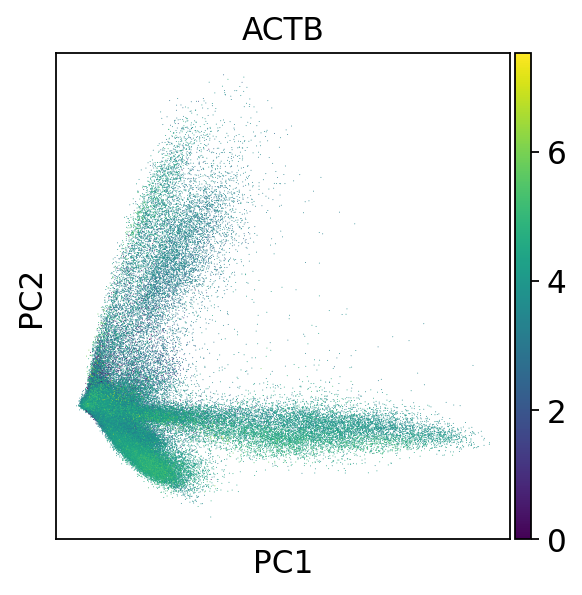

In [209]:
plt.rcParams['figure.figsize'] = [4, 4]
sc.pl.pca(adata, color='ACTB')

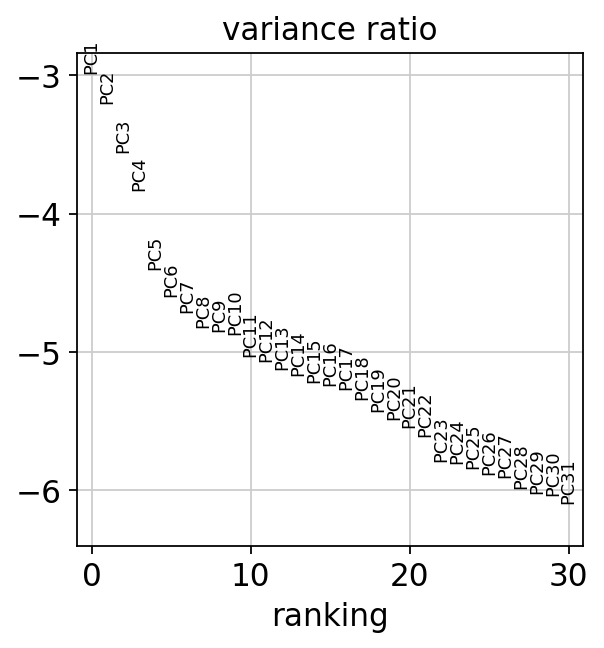

In [208]:
plt.rcParams['figure.figsize'] = [4, 4]
sc.pl.pca_variance_ratio(adata, log=True)

In [18]:
%%capture
sc.pp.neighbors(adata,random_state=42);

In [19]:
sc.tl.leiden(adata,random_state=42)

In [20]:
sc.tl.umap(adata,random_state=42) #32

In [10]:
%%capture
adata.write(out_dir+"/"+cacheName+".h5ad",compression="gzip")

In [7]:
adata=sc.read_h5ad(out_dir+"/"+cacheName+".h5ad")

In [224]:
#update annotation (will be included automatically when adata is recreated from scratch)
#md.set_index(md.cellid,inplace=True)
#for c in md:
#    if c != 'cellid':
#        adata.obs[c]=md[c]

### Analysis - overview

In [210]:
adata.obs.head()

,batch,cell_id,name,condition,replicate,orig.ident,nCount_RNA,nFeature_RNA,percent.mito,RNA_snn_res.0.8,seurat_clusters,labels,labels_score,labels_unif,labels_cl,labels_cl_unif,ccpm,Quality,Order,run status,Note,date,run_pipeline,Channel Name,Lane,Index,cancer,site,reference,chemistry,flowcell,seq_dir,mode,min_umis,min_genes,percent_mito,expected_cells,total_droplets,z_dim,z_layers,channel_id,label_concordance,labels_cl_unif_per_channel,filt_median_genes,filt_median_umi,pass,ccpm_id,ccpm_id_long,sample,htapp,sequenced,annotated,fresh,frozen,path_tumor_present,cohort,stage_at_diagnosis,metastatic_presentation,biopsy_days_after_dob,biopsy_days_after_diagnosis,biopsy_days_after_metastasis,prior_lines_tx_metastatic,prior_lines_tx_total,ER_primary_fraction,ER_primary,ER_biopsy_fraction,ER_biopsy,ER_concordance,PR_primary_fraction,PR_primary,PR_biopsy_fraction,PR_biopsy,PR_concordance,HER2_primary,HER2_biopsy,HER2_concordance,receptors_primary,receptors_biopsy,site_biopsy,site_biopsy_detail,grade_breast,histology_breast,histology_breast2,histology_biopsy,inflammatory,tx_last_before,tx_last_before_start,tx_last_before_end,tx_last_before_start_rel,tx_last_before_end_rel,tx_last_before_response,tx_concurrent,tx_concurrent_start,tx_concurrent_end,tx_last_before_start_rel.1,tx_last_before_end_rel.1,tx_concurrent_response,tx_next_after,tx_next_after_start,tx_next_after_stop,tx_last_before_start_rel.2,tx_last_before_end_rel.2,tx_next_after_response,oncopanel_RB_CNV,oncopanel_RB_SNV,oncopanel_ESR1,oncopanel_PIK3CA,oncopanel_FOXA1,oncopanel_EGFR,oncopanel_ERBB2,oncopanel_ERBB3,oncopanel_ERBB4,oncopanel_AR,oncopanel_AURKA,oncopanel_AURKB,oncopanel_FGFR1,oncopanel_FGFR2,oncopanel_FGFR3,oncopanel_FGFR4,oncopanel_KRAS,oncopanel_HRAS,oncopanel_BRAF,oncopanel_AKT1,ccpm_id_core,ccpmID,sampleid,cnv_sample,cnv_cellid,cnv_cluster,cnv_cors,cnv_cors_max,cnv_score,cnv_ref_score,cnv_score_norm,cnv_score_norm_norm,cnv_max_cluster,cnv_condition,cnv_mode,cnv_score_norm_norm2,cnv_cell_type,cnv_pass,cnv_pass_mal,pam50_cellid,pam50_Basal_single,pam50_Her2_single,pam50_LumA_single,pam50_LumB_single,pam50_Normal_single,pam50_mode_single,pam50_subtype_single,pam50_subtype_prob_single,pam50_subtype_filt_single,pam50_Basal_cluster,pam50_Her2_cluster,pam50_LumA_cluster,pam50_LumB_cluster,pam50_Normal_cluster,pam50_mode_cluster,pam50_subtype_cluster,pam50_subtype_prob_cluster,pam50_subtype_filt_cluster,S.Score,G2M.Score,Phase,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,n_counts,leiden
cellid,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
HTAPP-983-SMP-7659-fresh-channel1_CTCATTAAGTTCTACG-1,0,HTAPP-983-SMP-7659-fresh-channel1_CTCATTAAGTTC...,HTAPP-983-SMP-7659,fresh,channel1,HTAPP-983-SMP-7659-fresh-channel1,19976,5740,14.121946,7,7,Epithelial_cells,0.485269,Epithelial,Epithelial_cells,Epithelial,0300289_T1,pass,121,done5,nan,2019_07_25,True,0300289_T1,5,SI-GA-G9,breast,liver,GRCh38_v3.0.0,SC3Pv3,H2VV5CCX2,/transfer/190721_SL-HXE_1007_BFC...,V3,0,0,60,500,30000,200,1000,HTAPP-983-SMP-7659_fresh_channel1,True,4288,1353.0,2928.0,True,289.0,300289,T1,HTAPP,True,True,True,False,True,post-2019,IV,De novo,14267,1466,1466,5,5,0.8,Positive,0.95,Positive,True,0.8,Positive,0.9,Positive,True,Positive,Positive,True,nan,ER+/PR+/HER2+,Liver,nan,2,Invasive ductal carcinoma with mucinous features,Mucinous features,Metastatic carcinoma,False,Olaparib,14216,14259,-51,-8,Intrinsic resistance,nan,nan,nan,nan,nan,nan,Trastuzumab/Capecitabine,14272,14497,5,230,Sensitive,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,0300289T1,0300289T1,HTAPP-983-SMP-7659,HTAPP-983-SMP-7659,HTAPP-983-SMP-7659-fresh-channel1_CTCATTAAGTTC...,Epithelial_2,0.939291,0.939291,0.010855,0.000903,12.019229,1.0,Epithelial_2,fresh,V3,1.0,Epithelial,True,True,HTAPP-983-SM

In [10]:
marker_genes=["ESR1","PGR","ERBB2","KRT8","KRT18","EPCAM","ACTB","PTPRC","CD3D","CD8A","CD4","CD19" ,"CD163","CD68","LYZ","MPO","HLA-DRA","CD74","THY1","PECAM1","VWF","ICAM1","VIM","COL1A1","CYP1A1", "ABCC2", "ALB","JCHAIN","LIPE","HBA1"]

In [ ]:
sc.pl.umap(adata, color=marker_genes,ncols=5)

In [ ]:
# standard params
plt.rcParams['figure.figsize'] = [7, 7]
#del adata.uns['labels_colors']
sc.pl.umap(adata, color=['labels_cl_unif'])

In [ ]:
# standard params
plt.rcParams['figure.figsize'] = [7, 7]
#del adata.uns['labels_colors']
sc.pl.umap(adata, color=['name'])

In [ ]:
# standard params
plt.rcParams['figure.figsize'] = [12, 12]
sc.pl.umap(adata, color=['name'],legend_loc='on data',legend_fontweight='normal')

In [ ]:
# standard params
plt.rcParams['figure.figsize'] = [7, 7]
#del adata.uns['labels_colors']
sc.pl.umap(adata, color=['receptors_biopsy'])

In [ ]:
plt.rcParams['figure.figsize'] = [7, 7]
#del adata.uns['labels_colors']
sc.pl.umap(adata, color=['site_biopsy'],legend_fontweight='normal')

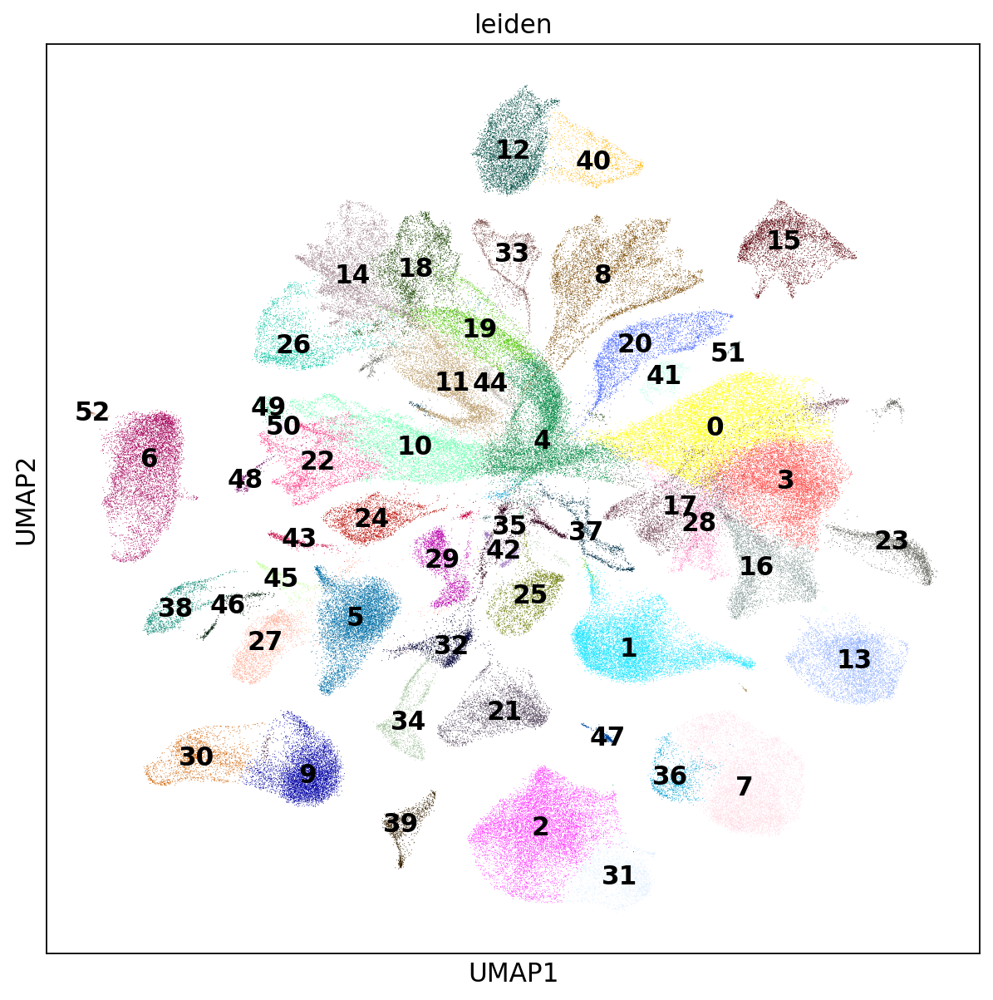

In [218]:
# standard params
plt.rcParams['figure.figsize'] = [9, 9]
sc.pl.umap(adata, color=['leiden'],legend_loc='on data')

In [ ]:
# standard params
plt.rcParams['figure.figsize'] = [7, 7]
sc.pl.umap(adata, color=['pam50_subtype_cluster'])

In [ ]:
# standard params
plt.rcParams['figure.figsize'] = [7, 7]
sc.pl.umap(adata, color=['Phase'])

In [ ]:
# standard params
plt.rcParams['figure.figsize'] = [7, 7]
sc.pl.umap(adata, color=['cnv_pass_mal'])

In [ ]:
# standard params
plt.rcParams['figure.figsize'] = [7, 7]
sc.pl.umap(adata, color=['cnv_pass'])

### Analysis - cleanup labels

In [13]:
#split clusters by likey malignant or not
adata.obs['leiden_mal']=adata.obs['leiden'].astype(str)+'_'+adata.obs['cnv_pass_mal'].astype(str)

In [14]:
#cleanup cluster-label assignments (assign maximum per cluster)
adata.obs['labels_cl_unif2_mal'] = adata.obs['leiden_mal'].map(adata.obs.groupby('leiden_mal')['labels_cl_unif'].value_counts().groupby('leiden_mal').idxmax().map(lambda x: x[1]))
adata.obs['labels_cl_unif2'] = adata.obs['leiden'].map(adata.obs.groupby('leiden')['labels_cl_unif'].value_counts().groupby('leiden').idxmax().map(lambda x: x[1]))

In [15]:
mal_ct=['Epithelial','Neurons','iPS_cells']

In [16]:
ct_mal_counts=pd.DataFrame(adata.obs[['labels_cl_unif2','labels_cl_unif2_mal','cnv_pass_mal']].value_counts()).reset_index()
ct_mal_counts[((ct_mal_counts.labels_cl_unif2_mal.isin(mal_ct))&(ct_mal_counts.cnv_pass_mal=="False"))|((~ct_mal_counts.labels_cl_unif2_mal.isin(mal_ct))&(ct_mal_counts.cnv_pass_mal=="True")|(ct_mal_counts.labels_cl_unif2.isin(mal_ct))&(ct_mal_counts.cnv_pass_mal=="False"))|((~ct_mal_counts.labels_cl_unif2.isin(mal_ct))&(ct_mal_counts.cnv_pass_mal=="True"))].sort_values(["cnv_pass_mal",0])

,labels_cl_unif2,labels_cl_unif2_mal,cnv_pass_mal,0
35,Epithelial,Monocyte,False,2
34,Epithelial,Fibroblast,False,4
32,Epithelial,NK,False,12
31,Epithelial,Endothelial,False,13
30,Epithelial,CD8+ T-cells,False,16
29,Epithelial,HSC,False,20
20,Epithelial,Epithelial,False,153
16,Epithelial,Macrophage,False,305
36,Chondrocyte,Adipocytes,True,1
37,Macrophage,Monocyte,True,1


/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
... storing 'leiden_mal' as categorical
... storing 'labels_cl_unif2_mal' as categorical
... storing 'labels_cl_unif2' as categorical


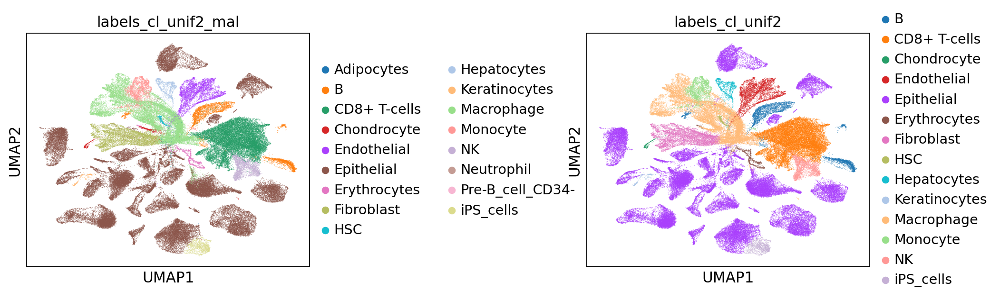

In [17]:
sc.pl.umap(adata, color=['labels_cl_unif2_mal','labels_cl_unif2'],legend_fontweight='normal',wspace=0.8)

#### Check "normal" cell types with positiv cnv status 

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.


<AxesSubplot:title={'center':'labels_cl_unif2_mal'}, xlabel='UMAP1', ylabel='UMAP2'>

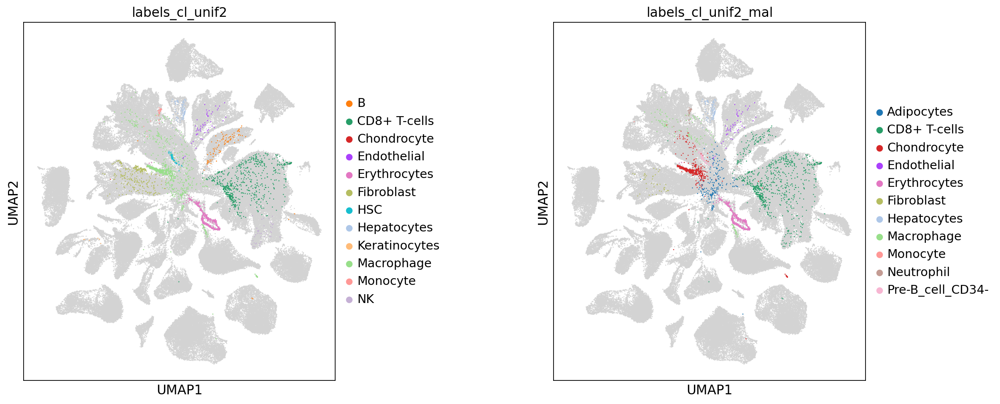

In [18]:
# plot normal cell types that have a positve cnv score
colors=pd.Series(adata.uns["labels_cl_unif2_mal_colors"],index=adata.obs["labels_cl_unif2_mal"].dtype.categories)[adata[~(adata.obs.labels_cl_unif2.isin(mal_ct))&(adata.obs.cnv_pass_mal=='True')].obs["labels_cl_unif2"].dtype.categories]
colors_mal=pd.Series(adata.uns["labels_cl_unif2_mal_colors"],index=adata.obs["labels_cl_unif2_mal"].dtype.categories)[adata[~(adata.obs.labels_cl_unif2_mal.isin(mal_ct))&(adata.obs.cnv_pass_mal=='True')].obs["labels_cl_unif2_mal"].dtype.categories]
fig, axs = plt.subplots(1,2,figsize=(16,7),gridspec_kw={'wspace':0.7})
sc.pl.umap(adata, size=5, show=False, ax=axs[0])
sc.pl.umap(adata[~(adata.obs.labels_cl_unif2.isin(mal_ct))&(adata.obs.cnv_pass_mal=='True')], color=['labels_cl_unif2'],legend_fontweight='normal',ax=axs[0],size=5, show=False,palette=colors.values.tolist())
sc.pl.umap(adata, size=5, show=False, ax=axs[1])
sc.pl.umap(adata[~(adata.obs.labels_cl_unif2_mal.isin(mal_ct))&(adata.obs.cnv_pass_mal=='True')], color=['labels_cl_unif2_mal'],legend_fontweight='normal',ax=axs[1],size=5, show=False,palette=colors_mal.values.tolist())

In [21]:
adata.obs.loc[~(adata.obs.labels_cl_unif2.isin(mal_ct))&(adata.obs.cnv_pass_mal=='True')][['name','labels_cl_unif']].value_counts().head(n=20)

name                labels_cl_unif  
HTAPP-586-SMP-8599  Chondrocyte         392
HTAPP-414-SMP-1681  Erythrocytes        387
HTAPP-627-SMP-3242  CD8+ T-cells        267
HTAPP-735-SMP-3841  CD8+ T-cells        129
HTAPP-783-SMP-4081  CD8+ T-cells        110
HTAPP-414-SMP-1681  CD8+ T-cells        106
HTAPP-262-SMP-602   Epithelial          104
HTAPP-364-SMP-1321  Epithelial           86
HTAPP-414-SMP-1681  Adipocytes           69
                    BM & Prog.           68
HTAPP-611-SMP-3062  Macrophage           58
HTAPP-285-SMP-751   Fibroblast           43
HTAPP-423-SMP-1741  HSC                  41
HTAPP-783-SMP-4081  Pre-B_cell_CD34-     40
HTAPP-812-SMP-8239  Adipocytes           40
HTAPP-627-SMP-3242  Hepatocytes          38
                    Neutrophil           38
HTAPP-414-SMP-1681  BM                   38
HTAPP-364-SMP-1321  CD8+ T-cells         37
HTAPP-812-SMP-8239  Fibroblast           30
dtype: int64

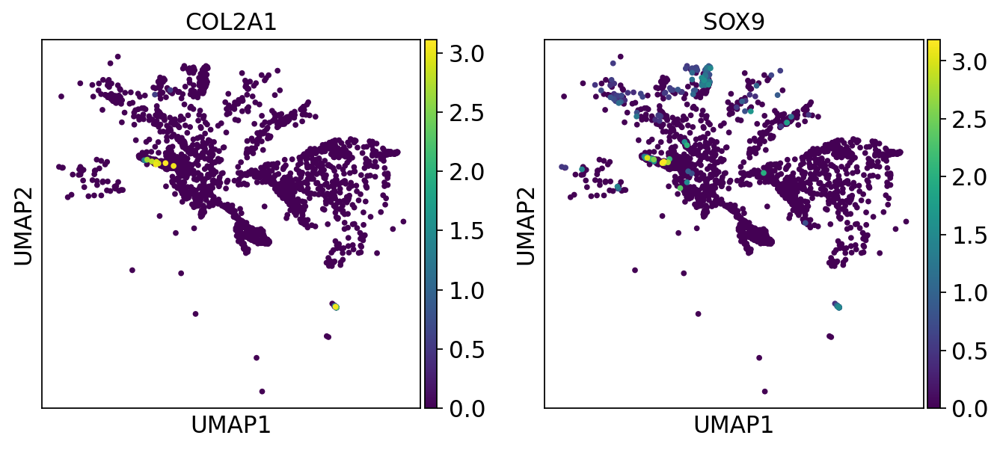

In [22]:
plt.rcParams['figure.figsize'] = [4, 4]
sc.pl.umap(adata[~(adata.obs.labels_cl_unif2_mal.isin(mal_ct))&(adata.obs.cnv_pass_mal=='True')], color=['COL2A1','SOX9'],legend_fontweight='normal')

In [23]:
mix_counts=pd.DataFrame(adata.obs[~(adata.obs.labels_cl_unif2.isin(mal_ct))&(adata.obs.cnv_pass_mal=='True')][["labels_cl_unif2_mal","labels_cl_unif2"]].value_counts()).reset_index()
mix_counts[(mix_counts['labels_cl_unif2_mal'].astype(str)!=mix_counts['labels_cl_unif2'].astype(str))]

,labels_cl_unif2_mal,labels_cl_unif2,0
1,Chondrocyte,Macrophage,585
3,Epithelial,Fibroblast,250
4,Adipocytes,Macrophage,194
7,CD8+ T-cells,B,92
8,Pre-B_cell_CD34-,HSC,57
10,CD8+ T-cells,NK,43
12,Neutrophil,Monocyte,34
13,Epithelial,Keratinocytes,6
14,Monocyte,Macrophage,1
15,Adipocytes,Chondrocyte,1


#### Check malignant cell types without CNVs (especially relevant in breast biopsies, where there might be normal breast epithelial cells

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.


<AxesSubplot:title={'center':'labels_cl_unif2'}, xlabel='UMAP1', ylabel='UMAP2'>

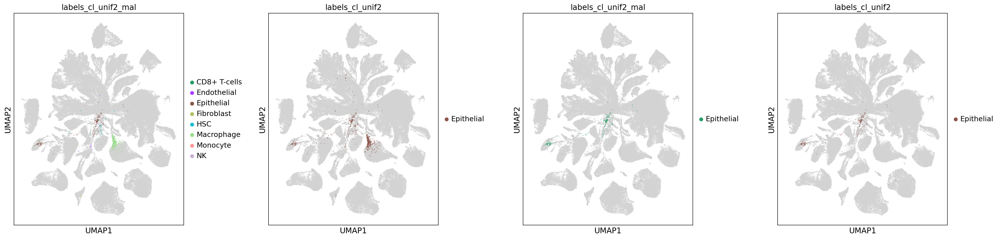

In [24]:
# plot malignant cell types that have a negative cnv score
colors=pd.Series(adata.uns["labels_cl_unif2_mal_colors"],index=adata.obs["labels_cl_unif2_mal"].dtype.categories)[adata[(adata.obs.labels_cl_unif2.isin(mal_ct))&(adata.obs.cnv_pass_mal=='False')].obs["labels_cl_unif2_mal"].dtype.categories]
colors_mal=pd.Series(adata.uns["labels_cl_unif2_mal_colors"],index=adata.obs["labels_cl_unif2_mal"].dtype.categories)[adata[(adata.obs.labels_cl_unif2_mal.isin(mal_ct))&(adata.obs.cnv_pass_mal=='False')].obs["labels_cl_unif2"].dtype.categories]
fig, axs = plt.subplots(1,4,figsize=(30,7),gridspec_kw={'wspace':0.5})
sc.pl.umap(adata, size=5, show=False, ax=axs[0])
sc.pl.umap(adata[(adata.obs.labels_cl_unif2.isin(mal_ct))&(adata.obs.cnv_pass_mal=='False')], color=['labels_cl_unif2_mal'],legend_fontweight='normal',ax=axs[0],size=5, show=False,palette=colors.values.tolist())
sc.pl.umap(adata, size=5, show=False, ax=axs[1])
sc.pl.umap(adata[(adata.obs.labels_cl_unif2.isin(mal_ct))&(adata.obs.cnv_pass_mal=='False')], color=['labels_cl_unif2'],legend_fontweight='normal',ax=axs[1],size=5, show=False,palette=colors_mal.values.tolist())
sc.pl.umap(adata, size=5, show=False, ax=axs[2])
sc.pl.umap(adata[(adata.obs.labels_cl_unif2_mal.isin(mal_ct))&(adata.obs.cnv_pass_mal=='False')], color=['labels_cl_unif2_mal'],legend_fontweight='normal',ax=axs[2],size=5, show=False,palette=colors.values.tolist())
sc.pl.umap(adata, size=5, show=False, ax=axs[3])
sc.pl.umap(adata[(adata.obs.labels_cl_unif2_mal.isin(mal_ct))&(adata.obs.cnv_pass_mal=='False')], color=['labels_cl_unif2'],legend_fontweight='normal',ax=axs[3],size=5, show=False,palette=colors_mal.values.tolist())

In [25]:
# check cluster composiotion and cnv_score to sprcifically check for potential "healthy" epithelial cells
md_epithelial=adata.obs[adata.obs['labels_cl_unif2'].isin(mal_ct)].copy()
md_epithelial['name']=pd.Categorical(md_epithelial['name'], categories=md_epithelial.groupby('name').mean('cnv_score').sort_values('cnv_score').index.tolist())

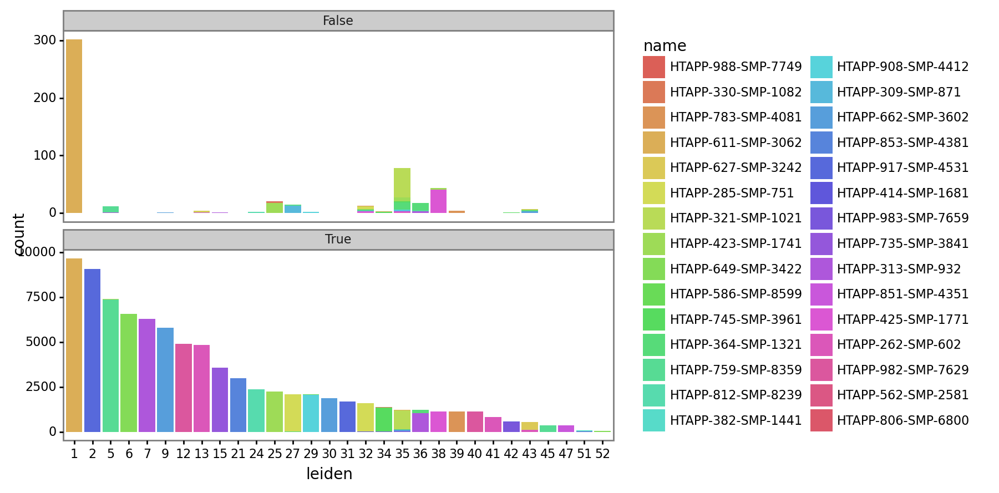

<ggplot: (2970439191325)>

In [32]:
ggplot(md_epithelial,aes(x='leiden',fill='name'))+geom_bar()+facet_wrap('cnv_pass_mal',ncol=1,scales="free_y")

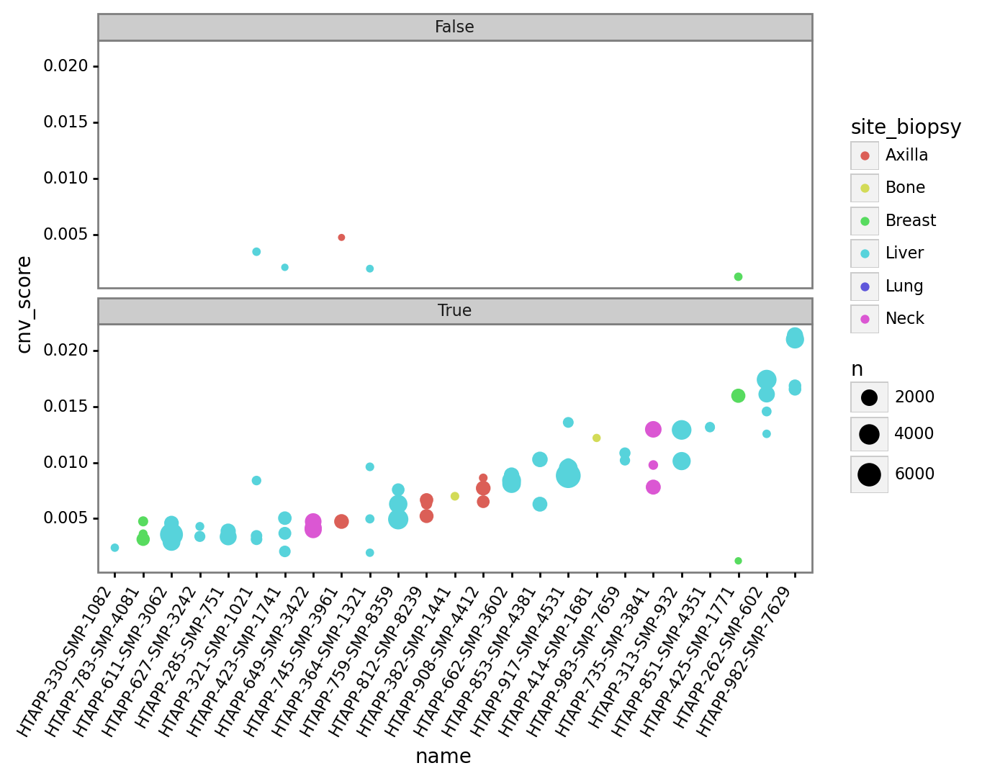

<ggplot: (-9223369066415762656)>

In [29]:
ggplot(md_epithelial[md_epithelial.cnv_cell_type.isin(mal_ct)],aes(x='name',y='cnv_score',color='site_biopsy'))+geom_count()+rotate_labels()+facet_wrap('cnv_pass_mal',ncol=1)

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


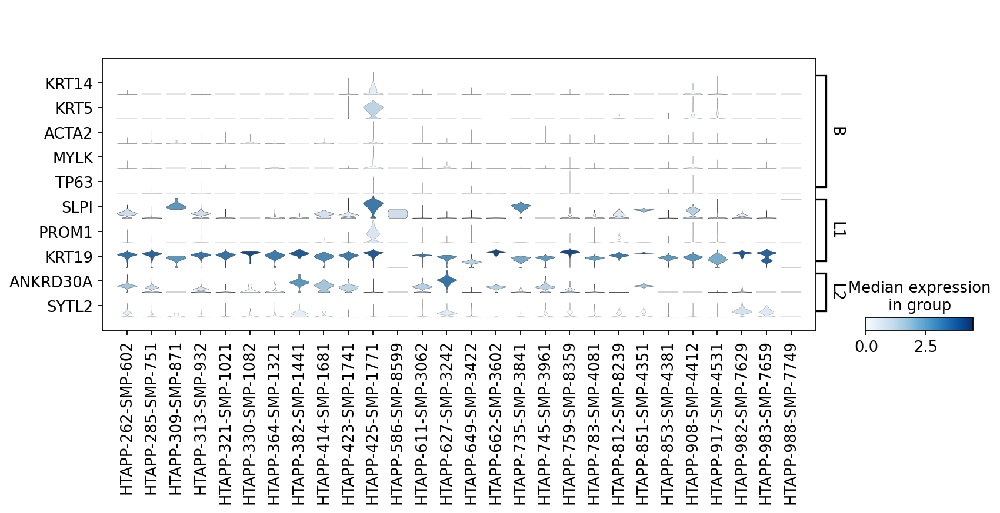

In [30]:
# check expression of genes that characterize normal breast epithelial cells (no guarantee that they are not expressed in malignant, though)
plt.rcParams['figure.figsize'] = [7, 7]
sc.pl.stacked_violin(adata[adata.obs['labels_cl_unif2'].isin(mal_ct)], groupby='name',
                     var_names={"B":['KRT14','KRT5','ACTA2','MYLK','TP63'],"L1":['SLPI','PROM1','KRT19'],"L2":["ANKRD30A","SYTL2"]},swap_axes=True,)

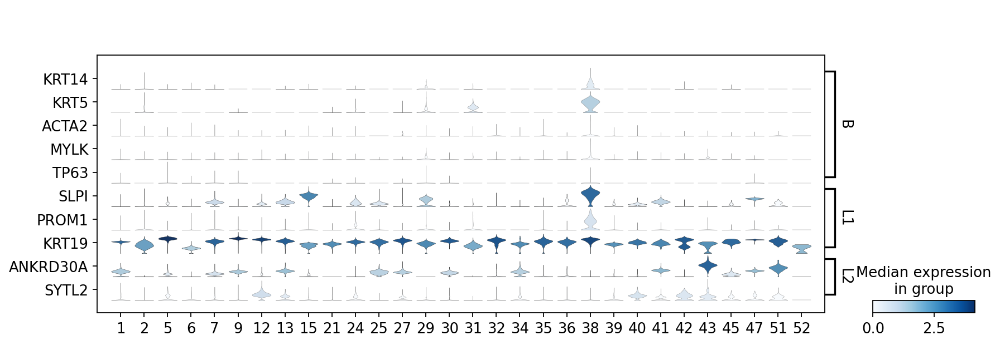

In [31]:
# check expression of genes that characterize normal breast epithelial cells (no guarantee that they are not expressed in malignant, though)
plt.rcParams['figure.figsize'] = [7, 7]
sc.pl.stacked_violin(adata[adata.obs['labels_cl_unif2'].isin(mal_ct)], groupby='leiden',
                     var_names={"B":['KRT14','KRT5','ACTA2','MYLK','TP63'],"L1":['SLPI','PROM1','KRT19'],"L2":["ANKRD30A","SYTL2"]},swap_axes=True,)

In [ ]:
# Including maligancy calls did recover additional populations (malignant chondrocytes) and did not introduce too much noise
# --> continue with "labels_cl_unif2_mal"

In [84]:
#unify some annotation
adata.obs['labels_cl_unif2_broad']=adata.obs['labels_cl_unif2_mal'].map(lambda x: "T" if x in ["CD8+ T-cells","CD4+ T-cells"] else 
                                                                  ("Epithelial_stem" if x in ["iPS_cells"] else 
                                                                   ("Mast" if x in ["HSC","Pre-B_cell_CD34-"] else x)))

In [85]:
#split some annotation
adata.obs['named_cluster']=adata.obs['labels_cl_unif2_mal'].astype(str)+'_'+adata.obs['leiden'].astype(str)
adata.obs['concat']=adata.obs['labels_cl_unif2_mal'].astype(str)+'_'+adata.obs['labels_cl_unif'].astype(str)
adata.obs['named_cluster_split'] = adata.obs['labels_cl_unif2_broad'].astype(str) + ('_' + adata.obs['leiden'].astype(str)) * (adata.obs['labels_cl_unif2_broad'].isin(['B',"Chondrocyte"]))

In [86]:
adata.obs['named_cluster_split'].value_counts()

Epithelial         83861
T                  26604
Macrophage         23080
Fibroblast          8277
Endothelial         5959
NK                  3540
Monocyte            3496
B_20                3188
B_23                2603
Epithelial_stem     1691
Hepatocytes         1547
Erythrocytes        1198
Chondrocyte_11       585
Mast                 547
Keratinocytes        352
Chondrocyte_48       264
Adipocytes           195
Neutrophil            34
Name: named_cluster_split, dtype: int64

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
... storing 'labels_cl_unif2_broad' as categorical
... storing 'named_cluster' as categorical
... storing 'concat' as categorical
... storing 'named_cluster_split' as categorical


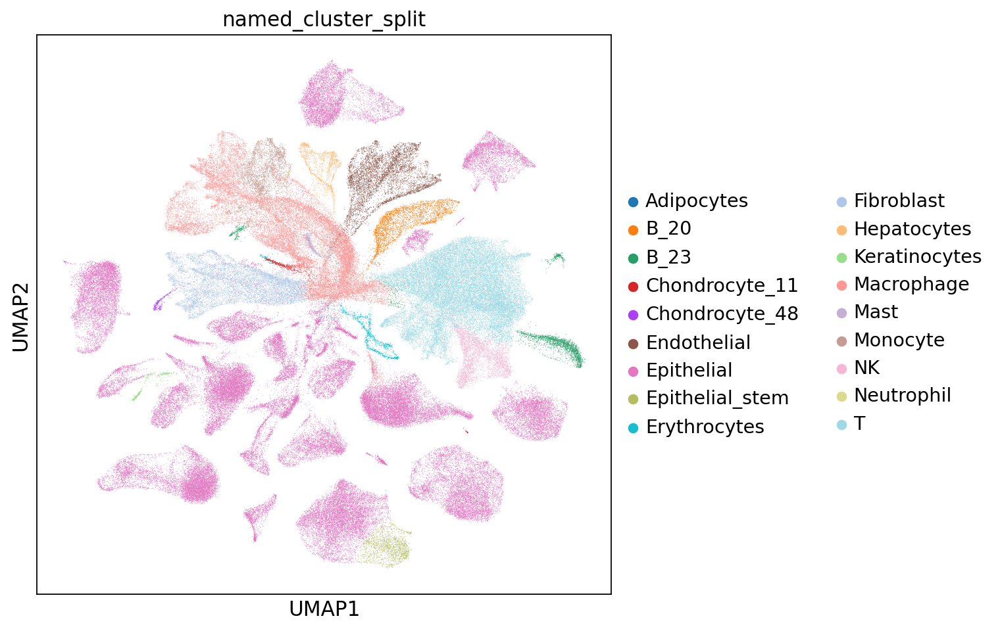

In [87]:
plt.rcParams['figure.figsize'] = [7, 7]
#del adata.uns['labels_colors']
sc.pl.umap(adata, color=['named_cluster_split'],legend_fontweight='normal')

In [89]:
#compartments
adata.obs['compartments']=adata.obs['named_cluster_split'].map(lambda x: "Lymphoid" if x in ["T","B_20","B_23","NK"] else 
                                                                  ("Myeloid" if x in ["Mast","Monocyte","Macrophage","Erythrocytes","CMP","Neutrophil"] else 
                                                                   ("Stromal" if x in ["Keratinocytes","Chondrocyte_48","Hepatocytes","Fibroblast","Endothelial","Adipocytes"] else 
                                                                    ("Malignant" if x in ["Epithelial","Epithelial_stem","Chondrocyte_11"] else x))))

#### select acceptable "misclassifications"

In [90]:
mix_df=pd.DataFrame(adata.obs.groupby('labels_cl_unif2_mal')['labels_cl_unif'].value_counts(normalize=False).groupby('labels_cl_unif2_mal').transform(lambda x: x/x.iloc[0]).rename('rat')).reset_index()

In [91]:
sel_combies=mix_df[mix_df.rat>0.4].copy()
sel_combies['concat']=sel_combies['labels_cl_unif2_mal'].astype(str)+'_'+sel_combies['labels_cl_unif'].astype(str)
sel_combies['concat_rev']=sel_combies['labels_cl_unif'].astype(str)+'_'+sel_combies['labels_cl_unif2_mal'].astype(str)
sel_combies.loc[(sel_combies['labels_cl_unif2_mal'].astype(str)!=sel_combies['labels_cl_unif'].astype(str))]

,labels_cl_unif2_mal,labels_cl_unif,rat,concat,concat_rev
1,Adipocytes,Epithelial,0.829268,Adipocytes_Epithelial,Epithelial_Adipocytes
2,Adipocytes,HSC,0.780488,Adipocytes_HSC,HSC_Adipocytes
3,Adipocytes,CD8+ T-cells,0.585366,Adipocytes_CD8+ T-cells,CD8+ T-cells_Adipocytes
4,Adipocytes,Macrophage,0.536585,Adipocytes_Macrophage,Macrophage_Adipocytes
154,Keratinocytes,Epithelial,0.966887,Keratinocytes_Epithelial,Epithelial_Keratinocytes
182,Monocyte,Macrophage,0.437365,Monocyte_Macrophage,Macrophage_Monocyte
193,NK,CD8+ T-cells,0.657670,NK_CD8+ T-cells,CD8+ T-cells_NK


#### Create subsetted objects

In [93]:
adata.obs['select_cell']=((adata.obs['concat'].astype('str').isin(sel_combies.concat.astype('str').append(sel_combies.concat_rev.astype('str'))
                                                                  .append(pd.Series("Epithelial_iPS_cells")))))

In [94]:
adata.obs.groupby('labels_cl_unif2_mal')['select_cell'].value_counts()

labels_cl_unif2_mal  select_cell
Adipocytes           True             153
                     False             42
B                    True            4933
                     False            858
CD8+ T-cells         True           25767
                     False            837
Chondrocyte          True             641
                     False            208
Endothelial          True            5621
                     False            338
Epithelial           True           83079
                     False            782
Erythrocytes         True             742
                     False            456
Fibroblast           True            7781
                     False            496
HSC                  False            278
                     True             212
Hepatocytes          True            1298
                     False            249
Keratinocytes        True             297
                     False             55
Macrophage           True           19016
 

In [95]:
#Check unexpected cnv status
ct_mal_counts=pd.DataFrame(adata.obs[adata.obs['select_cell']==True][['labels_cl_unif2','labels_cl_unif2_mal','cnv_pass_mal']].value_counts()).reset_index()
ct_mal_counts[((ct_mal_counts.labels_cl_unif2_mal.isin(mal_ct))&(ct_mal_counts.cnv_pass_mal=="False"))|((~ct_mal_counts.labels_cl_unif2_mal.isin(mal_ct))&(ct_mal_counts.cnv_pass_mal=="True")|(ct_mal_counts.labels_cl_unif2.isin(mal_ct))&(ct_mal_counts.cnv_pass_mal=="False"))|((~ct_mal_counts.labels_cl_unif2.isin(mal_ct))&(ct_mal_counts.cnv_pass_mal=="True"))].sort_values(["cnv_pass_mal",0])

,labels_cl_unif2,labels_cl_unif2_mal,cnv_pass_mal,0
35,Epithelial,Monocyte,False,2
33,Epithelial,Fibroblast,False,4
34,Epithelial,Endothelial,False,4
31,Epithelial,NK,False,5
30,Epithelial,CD8+ T-cells,False,8
29,Epithelial,HSC,False,14
21,Epithelial,Epithelial,False,114
18,Epithelial,Macrophage,False,152
36,Macrophage,Monocyte,True,1
37,Chondrocyte,Adipocytes,True,1


/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
... storing 'compartments' as categorical


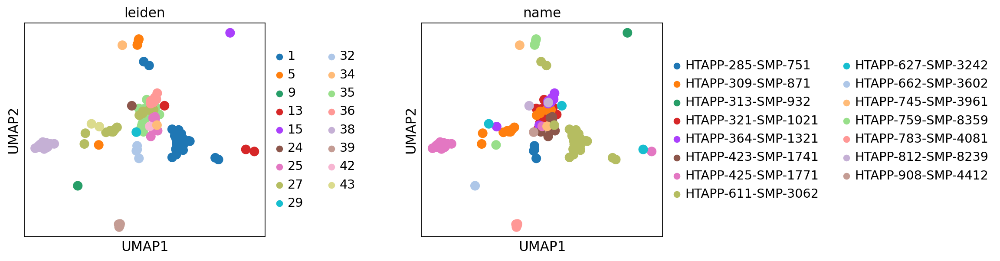

In [96]:
plt.rcParams['figure.figsize'] = [4, 4]
sc.pl.umap(adata[(adata.obs.select_cell==True)&((adata.obs.labels_cl_unif2.isin(mal_ct))|(adata.obs.labels_cl_unif2_mal.isin(mal_ct)))&(adata.obs.cnv_pass_mal=="False")].copy(), color=['leiden','name'],legend_fontweight='normal',wspace=0.5)

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
... storing 'compartments' as categorical


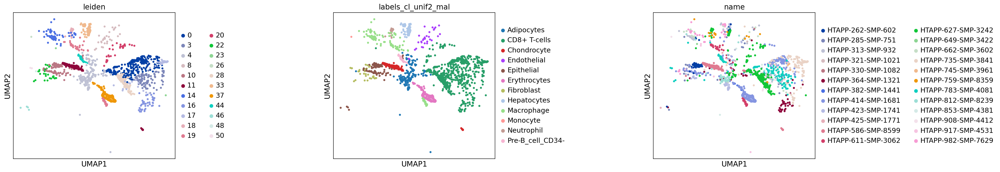

In [97]:
plt.rcParams['figure.figsize'] = [5, 5]
sc.pl.umap(adata[(adata.obs.select_cell==True)&((~adata.obs.labels_cl_unif2.isin(mal_ct))|(~adata.obs.labels_cl_unif2_mal.isin(mal_ct)))&(adata.obs.cnv_pass_mal=="True")].copy(), color=['leiden','labels_cl_unif2_mal','name'],legend_fontweight='normal',wspace=0.8)

In [98]:
#remove all malignat cell types that don't pass cnv because they don't cluster together but split across many clusters and also remove the "normal" Macrophages and Adipocytes with cnv because they occur in unexpected/dirty clusters 
adata.obs.loc[(adata.obs.select_cell==True)&((adata.obs.labels_cl_unif2.isin(mal_ct))|(adata.obs.labels_cl_unif2_mal.isin(mal_ct)))&(adata.obs.cnv_pass_mal=="False"),['select_cell']]=False
adata.obs.loc[(adata.obs.select_cell==True)&((adata.obs.labels_cl_unif2_mal.isin(["Macrophage","Adipocytes"])))&(adata.obs.cnv_pass_mal=="True"),['select_cell']]=False

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
... storing 'compartments' as categorical


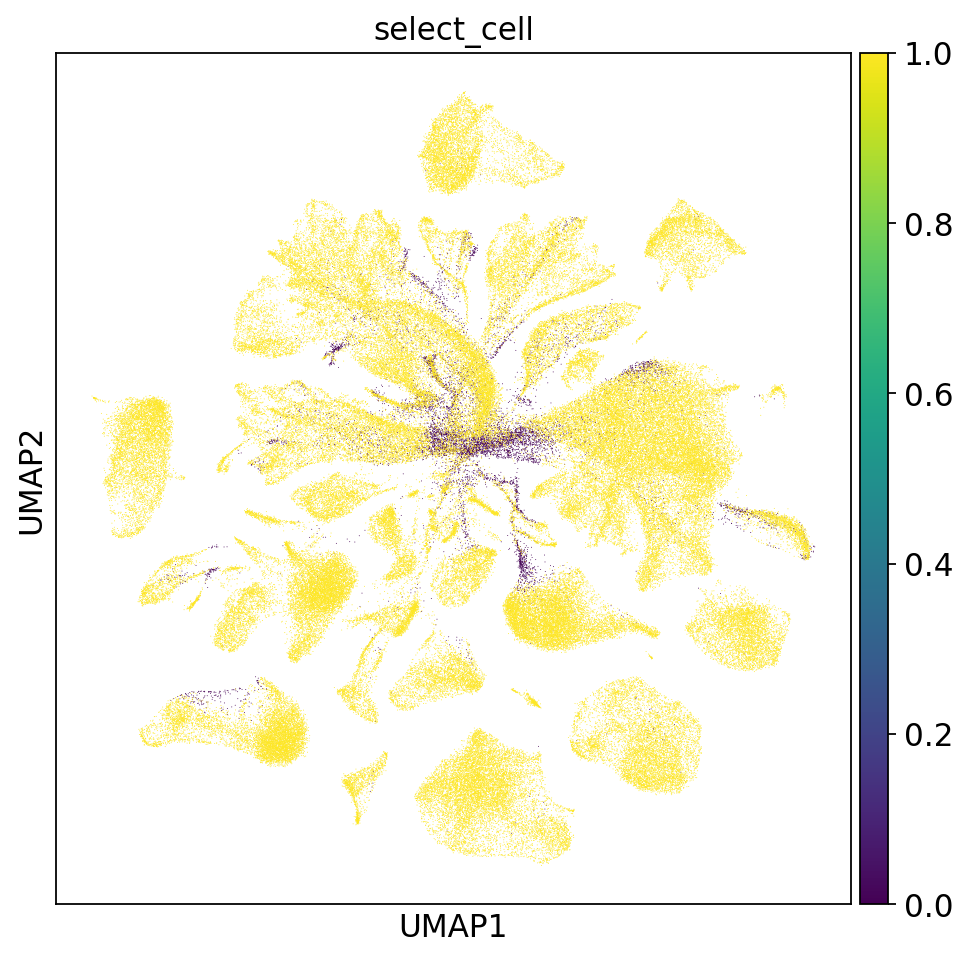

In [99]:
plt.rcParams['figure.figsize'] = [7, 7]
sc.pl.umap(adata, color=['select_cell'],legend_fontweight='normal')

In [100]:
%%capture
adata.write(out_dir+"/"+cacheName+".h5ad",compression="gzip")

In [8]:
#adata=sc.read_h5ad(out_dir+"/"+cacheName+".h5ad")

In [101]:
adata_sel=adata[(adata.obs['select_cell']==True)]

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


In [102]:
adata_sub=ini.downsample_to_smallest_category( adata_sel, 'named_cluster_split', min_cells=1000, keep_small_categories=True,random_state=42)

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


#### Downsampled

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


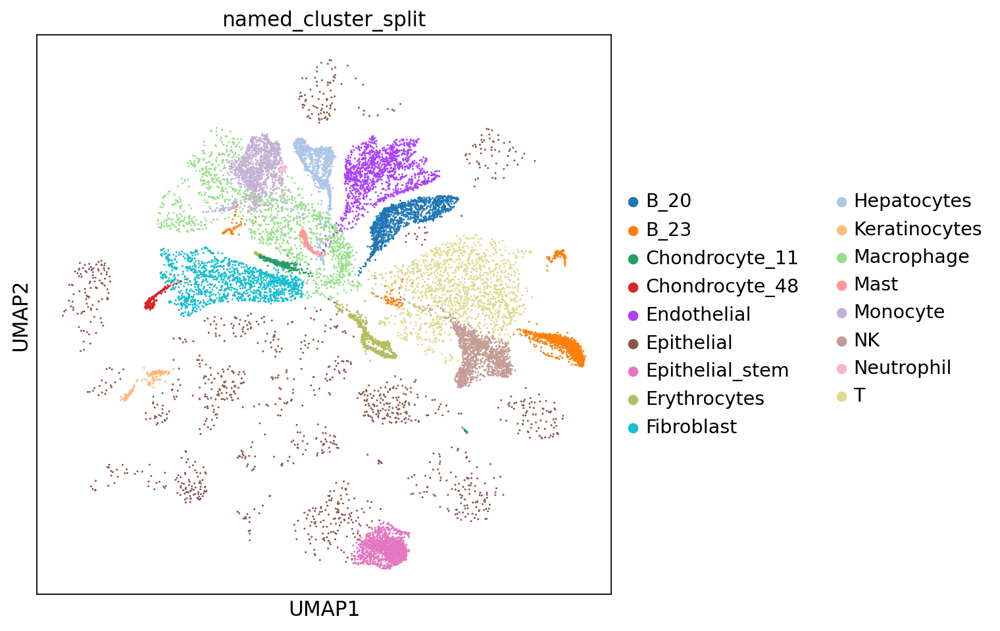

In [103]:
# standard params
plt.rcParams['figure.figsize'] = [7, 7]
#del adata.uns['labels_colors']
sc.pl.umap(adata_sub, color=['named_cluster_split'])

In [104]:
sc.tl.rank_genes_groups(adata_sub, 'named_cluster_split', method='t-test_overestim_var',pts=True)

In [105]:
de_info_sub=pd.concat([sc.get.rank_genes_groups_df(adata_sub, group=g)[:200].set_index('names').assign(pts=adata_sub.uns['rank_genes_groups']['pts'][g],pts_rest=adata_sub.uns['rank_genes_groups']['pts_rest'][g],type=g).reset_index() for g in adata_sub.obs['named_cluster_split'].unique()])
de_info_sub=de_info_sub.reset_index()
de_info_sub.head()

,index,names,scores,logfoldchanges,pvals,pvals_adj,pts,pts_rest,type
0,0,AIF1,102.355446,6.104311,0.0,0.0,0.985362,0.093047,Monocyte
1,1,LST1,96.124580,6.250728,0.0,0.0,0.977658,0.074022,Monocyte
2,2,LYZ,94.424538,7.294666,0.0,0.0,0.986903,0.098004,Monocyte
3,3,MNDA,88.310448,6.397876,0.0,0.0,0.958398,0.040796,Monocyte
4,4,FGL2,78.761360,5.755640,0.0,0.0,0.936826,0.060356,Monocyte


In [106]:
rest_thres=0.1

In [107]:
markers_sub=de_info_sub[de_info_sub.pts_rest<rest_thres].groupby('type').apply(lambda x: x['names'][:5])
markers_sub=dict(iter(markers_sub.reset_index().groupby('type')['names']))

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


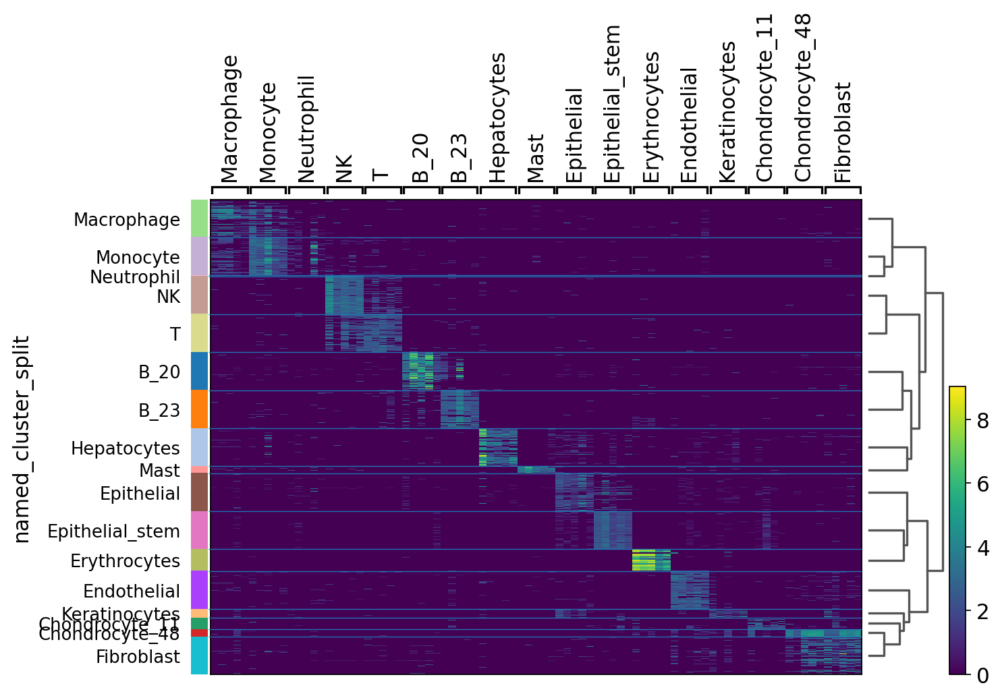

In [108]:
sc.tl.dendrogram(adata_sub,groupby='named_cluster_split')
sc.pl.heatmap(adata_sub, markers_sub, groupby='named_cluster_split', dendrogram=True)

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


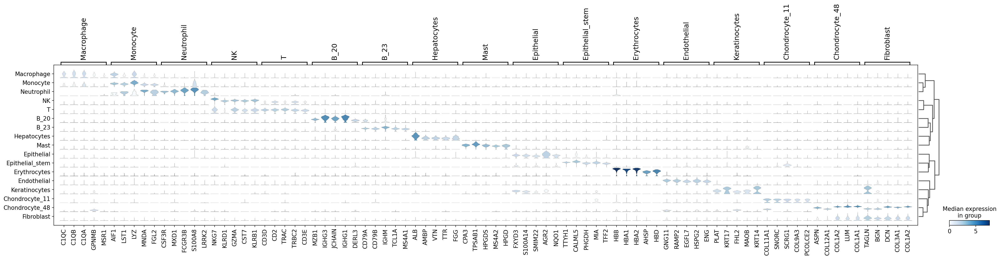

In [109]:
sc.tl.dendrogram(adata_sub,groupby='named_cluster_split')
sc.pl.stacked_violin(adata_sub,markers_sub, groupby='named_cluster_split', dendrogram=True)

#### Selected

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
Trying to set attribute `.uns` of view, copying.


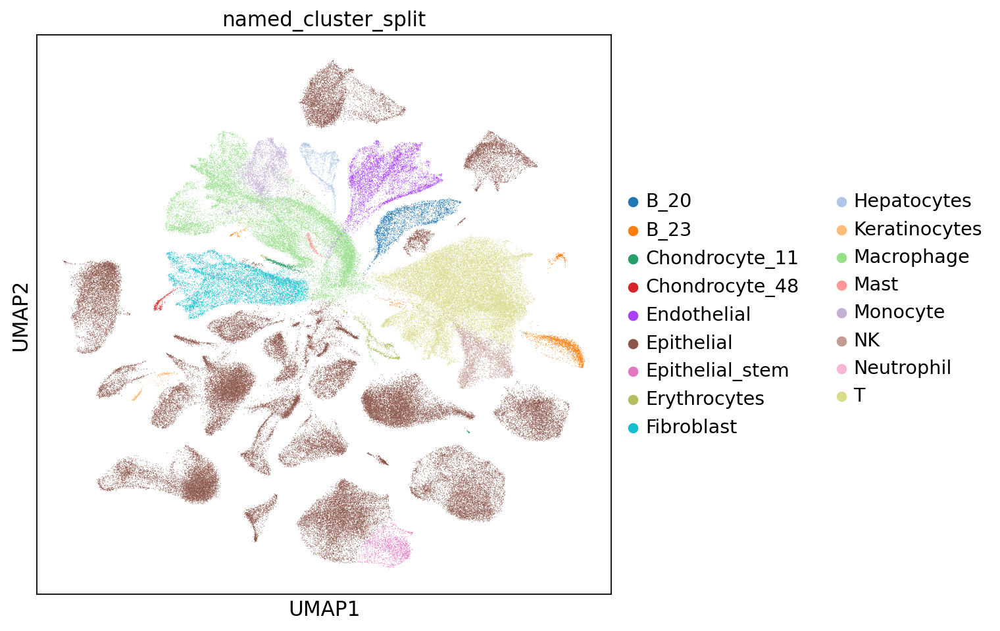

In [110]:
# standard params
plt.rcParams['figure.figsize'] = [7, 7]
#del adata.uns['labels_colors']
sc.pl.umap(adata_sel, color=['named_cluster_split'])

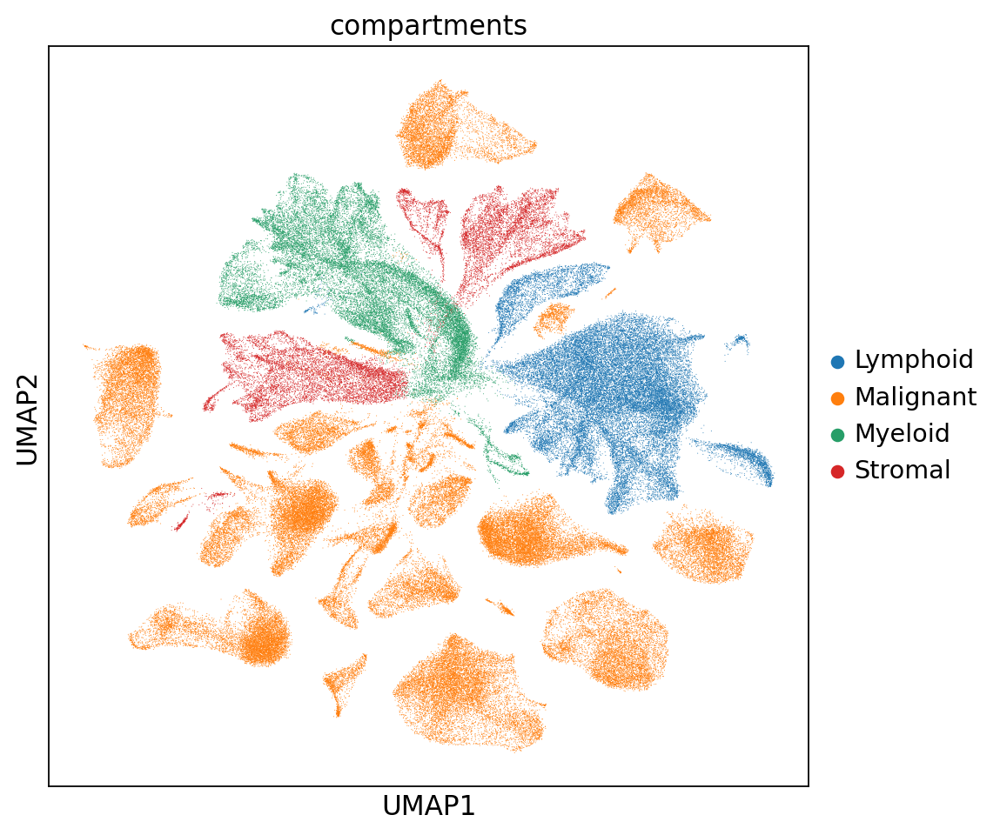

In [111]:
# standard params
plt.rcParams['figure.figsize'] = [7, 7]
#del adata.uns['labels_colors']
sc.pl.umap(adata_sel, color=['compartments'])

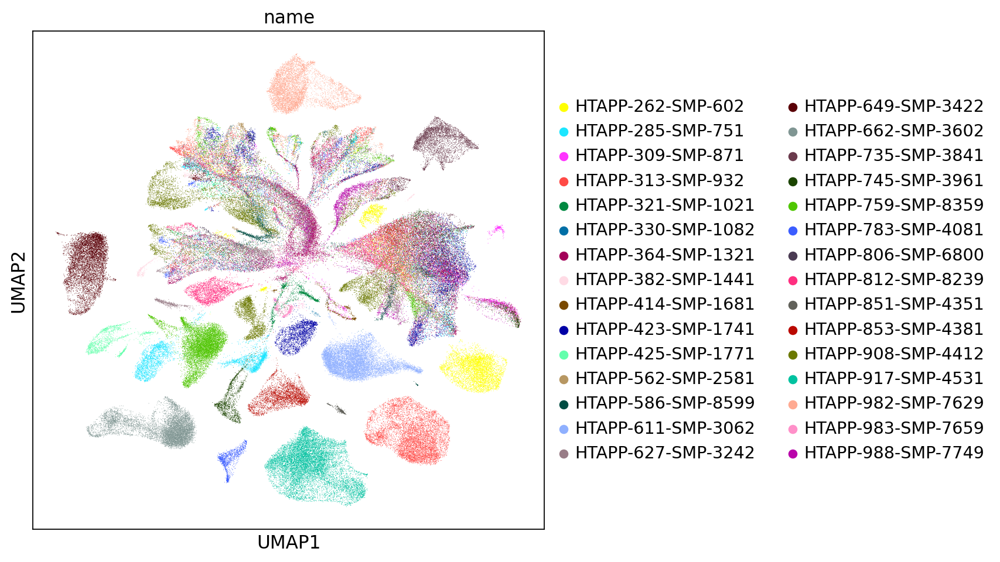

In [112]:
# standard params
plt.rcParams['figure.figsize'] = [7, 7]
#del adata.uns['labels_colors']
sc.pl.umap(adata_sel, color=['name'])

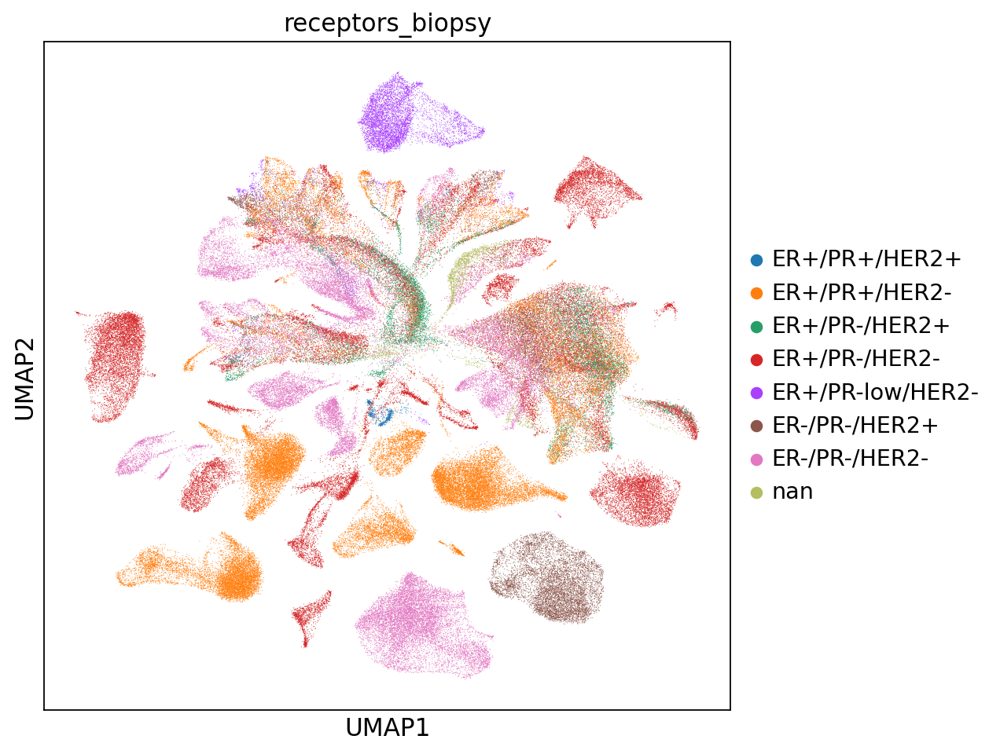

In [113]:
# standard params
plt.rcParams['figure.figsize'] = [7, 7]
#del adata.uns['labels_colors']
sc.pl.umap(adata_sel, color=['receptors_biopsy'])

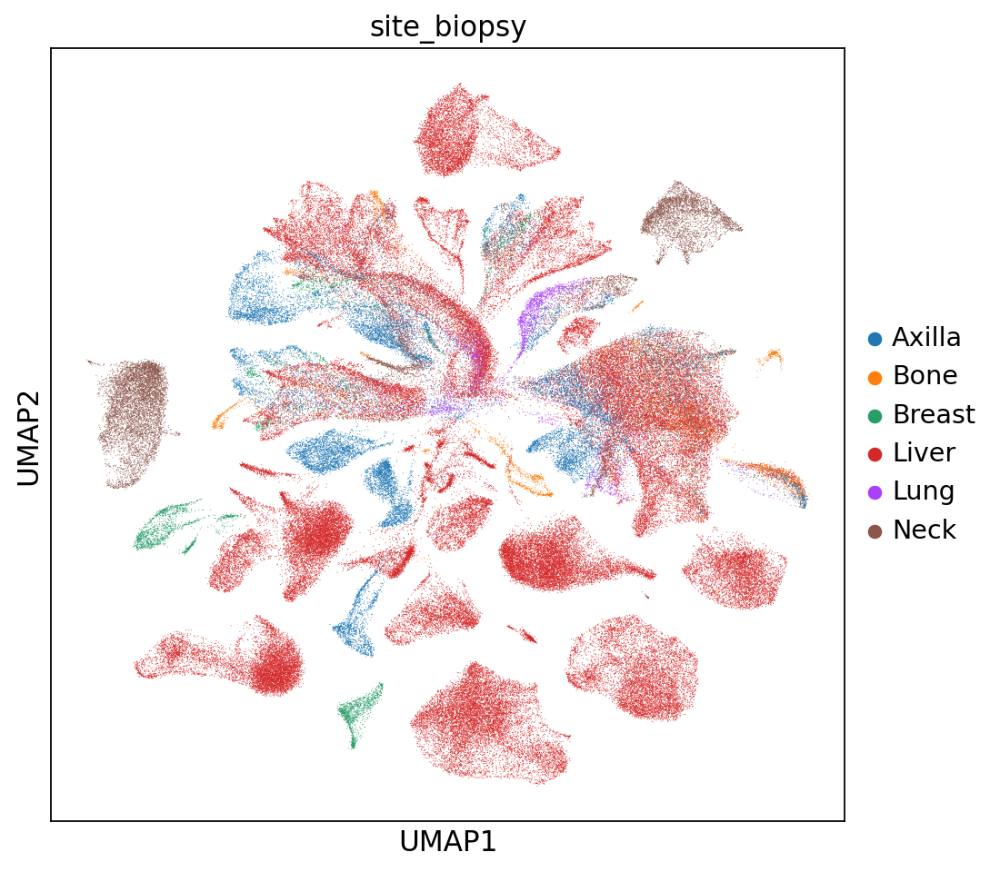

In [114]:
# standard params
plt.rcParams['figure.figsize'] = [7, 7]
#del adata.uns['labels_colors']
sc.pl.umap(adata_sel, color=['site_biopsy'])

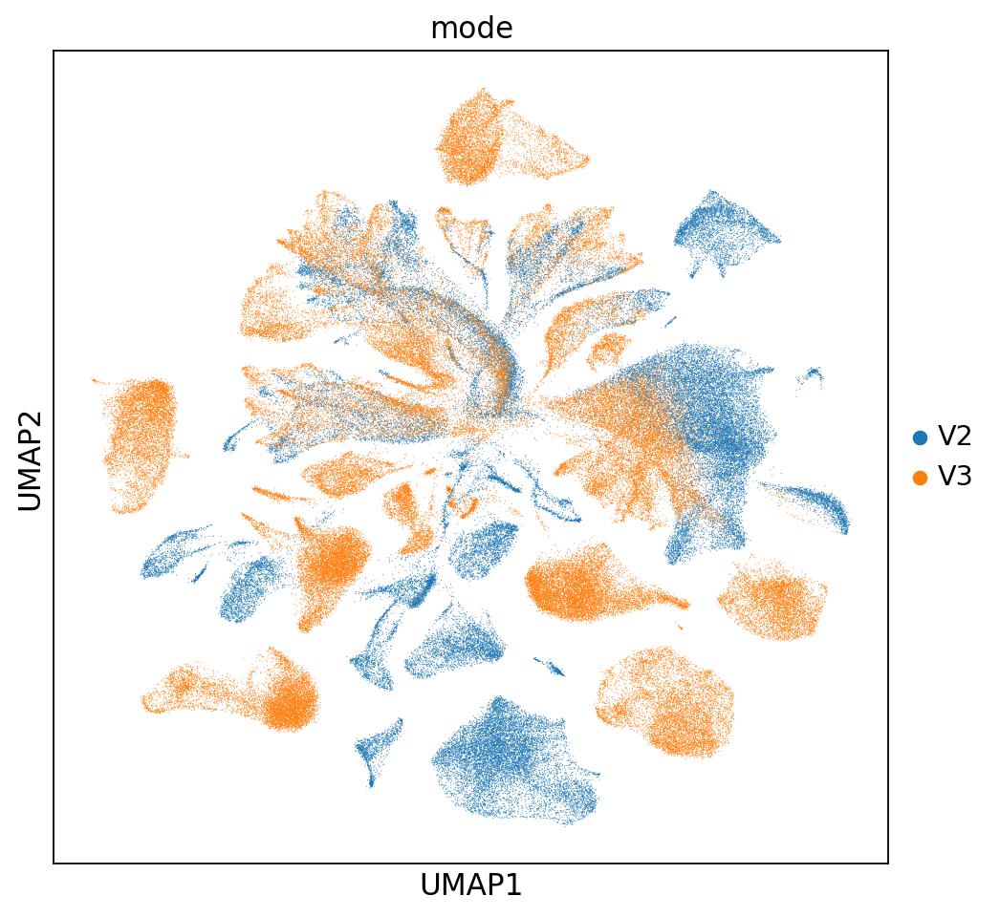

In [12]:
# standard params
plt.rcParams['figure.figsize'] = [7, 7]
sc.pl.umap(adata_sel, color=['mode'])

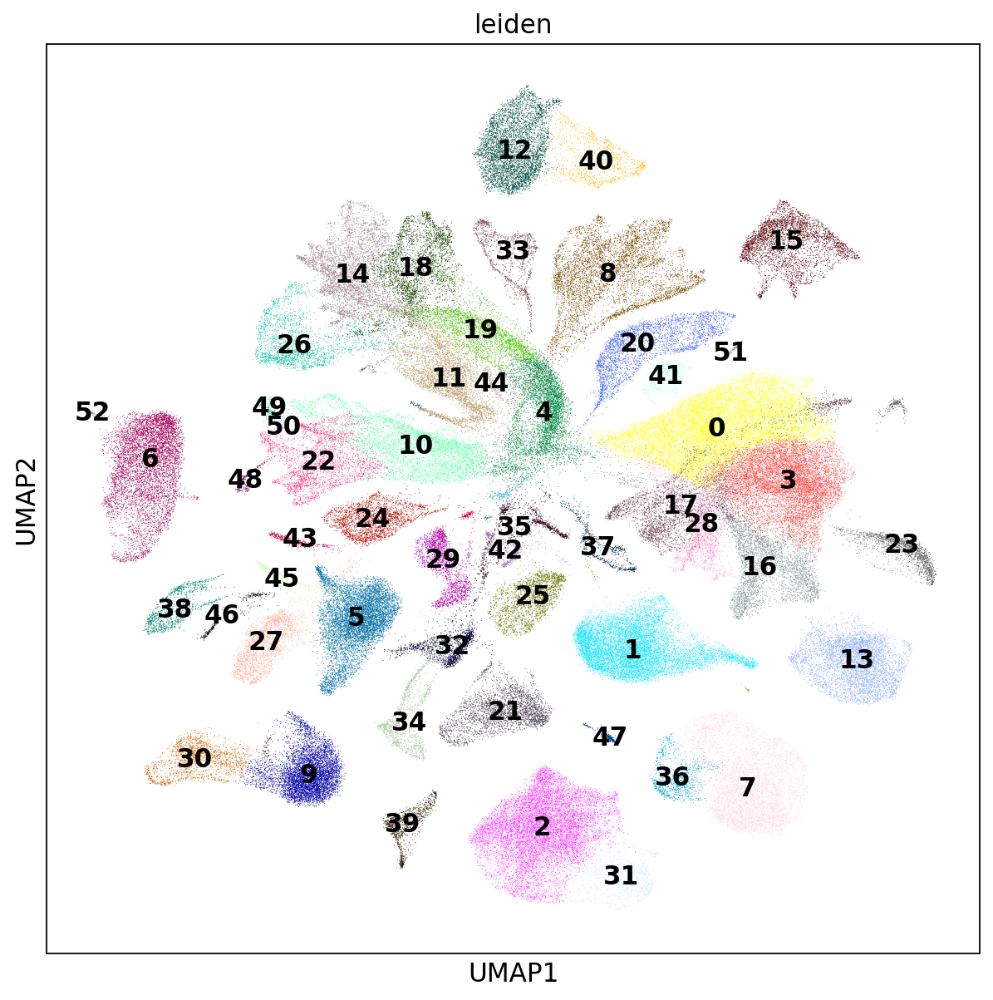

In [151]:
# standard params
plt.rcParams['figure.figsize'] = [9, 9]
sc.pl.umap(adata_sel, color=['leiden'],legend_loc='on data')

In [115]:
adata_sel.write(out_dir+"/"+cacheName+"_selected.h5ad", compression="gzip");

In [7]:
#adata_sel=sc.read_h5ad(out_dir+"/"+cacheName+"_selected.h5ad")

#### Stats

In [116]:
print(adata_sel.obs.nFeature_RNA.mean())
print(adata_sel.obs.n_genes_by_counts.mean())
print(adata_sel.obs.nFeature_RNA.median())
print(adata_sel.obs.n_genes_by_counts.median())
print(len(adata_sel.obs.index))
print(len(adata_sel.obs.name.unique()))

2060.652976239597
2060.9664066120317
1740.0
1740.0
157531
30


#### DE analysis

In [117]:
sc.tl.rank_genes_groups(adata_sel, 'named_cluster_split', method='t-test_overestim_var',pts=True)

In [118]:
de_info=pd.concat([sc.get.rank_genes_groups_df(adata_sel, group=g)[:200].set_index('names').assign(pts=adata_sel.uns['rank_genes_groups']['pts'][g],pts_rest=adata_sel.uns['rank_genes_groups']['pts_rest'][g],type=g).reset_index() for g in adata_sel.obs['named_cluster_split'].unique()])
de_info=de_info.reset_index()
de_info.head()

,index,names,scores,logfoldchanges,pvals,pvals_adj,pts,pts_rest,type
0,0,KRT19,787.660095,7.212701,0.0,0.0,0.984692,0.070059,Epithelial
1,1,KRT18,705.657227,6.046923,0.0,0.0,0.969071,0.101132,Epithelial
2,2,KRT8,694.235901,5.761660,0.0,0.0,0.973820,0.083108,Epithelial
3,3,FXYD3,672.816101,6.984408,0.0,0.0,0.922570,0.033688,Epithelial
4,4,SPINT2,582.668823,4.644947,0.0,0.0,0.950654,0.149224,Epithelial


In [119]:
rest_thres=0.1

In [120]:
markers=de_info[de_info.pts_rest<rest_thres].groupby('type').apply(lambda x: x['names'][:5])
markers=dict(iter(markers.reset_index().groupby('type')['names']))

In [121]:
dedf=pd.DataFrame(de_info[de_info.pts_rest<rest_thres].groupby('type').apply(lambda x: x['names']))
dedf=dict(iter(dedf.reset_index().groupby('type')['names']))

In [122]:
dedf = pd.DataFrame({k: v.reset_index(drop=True) for k, v in dedf.items()})

In [123]:
dedf

,B_20,B_23,Chondrocyte_11,Chondrocyte_48,Endothelial,Epithelial,Epithelial_stem,Erythrocytes,Fibroblast,Hepatocytes,Keratinocytes,Macrophage,Mast,Monocyte,NK,Neutrophil,T
0,IGKC,CD79A,COL11A1,ASPN,GNG11,KRT19,TTYH1,HBB,IGFBP7,ALB,PLAT,AIF1,CPA3,LST1,KLRD1,CSF3R,CD2
1,IGHG3,IGHM,SNORC,COL1A2,EGFL7,KRT8,MIA,HBA1,TAGLN,VTN,KRT17,TYROBP,TPSAB1,MNDA,KLRF1,MNDA,CD3D
2,JCHAIN,CD79B,CTHRC1,AEBP1,HSPG2,FXYD3,TFF2,HBA2,BGN,AMBP,NNMT,APOC1,HPGDS,FGL2,PRF1,FCGR3B,TRAC
3,IGLC2,TCL1A,SCRG1,COL1A1,IGFBP7,EPCAM,NOTCH1,AHSP,MYL9,TTR,MAOB,FCER1G,MS4A2,C1orf162,TRDC,S100A8,TRBC2
4,IGHG1,MS4A1,PCOLCE2,LUM,ENG,CD24,UBE2C,HBD,DCN,GC,KRT14,C1QA,HPGD,MS4A6A,CD247,LRRK2,CD69
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
161,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,LAMB1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
162,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PDE1A,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
163,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,CYGB,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
164,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,TUBB6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [124]:
dedf.to_csv(de_dir + "/fresh_DE.tsv",sep="\t")

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


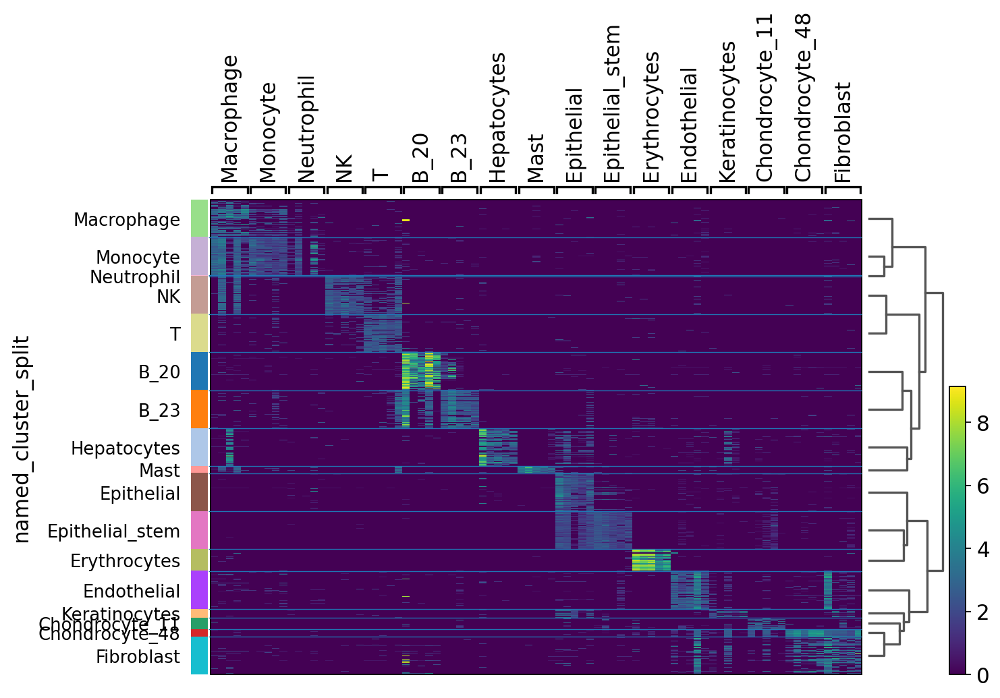

In [125]:
sc.tl.dendrogram(adata_sub,groupby='named_cluster_split')
sc.pl.heatmap(adata_sub, markers, groupby='named_cluster_split', dendrogram=True)

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


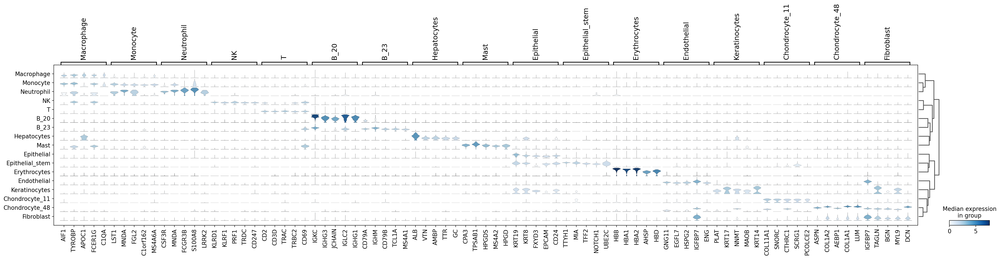

In [126]:
sc.pl.stacked_violin(adata_sel, markers, groupby='named_cluster_split', dendrogram=True)

#### Rename split clusters according to the DE analysis

In [153]:
types=['22','10']
get_sub_markers(adata_sel,types,key,col='leiden')

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


type     
10    203      SFRP2
      204      IGHG4
      205      MFAP5
      206        CFD
      207       APOD
      209      WISP2
      210         C3
      211        OGN
      212      APOC1
      214       IGF1
22    13      NOTCH3
      26     TINAGL1
      27       MEF2C
      29         ID4
      30       CARMN
      33        CAV2
      34       CSRP2
      38        EPS8
      50      PHLDA1
      54        MCAM
Name: names, dtype: object

In [129]:
types=['Chondrocyte_11','Chondrocyte_48']
get_sub_markers(adata_sel,types,key)

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


type               
Chondrocyte_11  5        SNORC
                9       COL9A3
                10      S100A1
                12     PCOLCE2
                15      COL9A1
                17        LY6D
                21        SAA1
                23       SFRP1
                27       PDIA2
                28       MGST1
Chondrocyte_48  200     COL1A2
                201     COL3A1
                202     RPL35A
                203     COL1A1
                204      AEBP1
                205     PRSS23
                206       ASPN
                207     IGFBP7
                208     S100A4
                209       CTSK
Name: names, dtype: object

In [130]:
ct_dict={l:l for l in adata_sel.obs['named_cluster_split'].unique()}
ct_dict["Chondrocyte_48"]="Chondrocyte"
ct_dict["Chondrocyte_11"]="MBC_chondroid"
ct_dict["Hepatocytes"]="Hepatocyte"
ct_dict["Keratinocytes"]="Keratinocyte"
ct_dict["Erythrocytes"]="Erythrocyte"
ct_dict["Epithelial"]="MBC"
ct_dict["Epithelial_stem"]="MBC_stem-like"
ct_dict["B_20"]="B_plasma"
ct_dict["B_23"]="B"

In [137]:
adata_sel.obs['cell_type']=adata_sel.obs['named_cluster_split'].map(ct_dict)

In [138]:
adata_sel.obs['cell_type'].unique()

array(['MBC', 'Endothelial', 'Macrophage', 'Fibroblast', 'Monocyte', 'T',
       'Chondrocyte', 'Erythrocyte', 'Hepatocyte', 'NK', 'B', 'B_plasma',
       'Mast', 'Keratinocyte', 'MBC_stem-like', 'Neutrophil',
       'MBC_chondroid'], dtype=object)

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


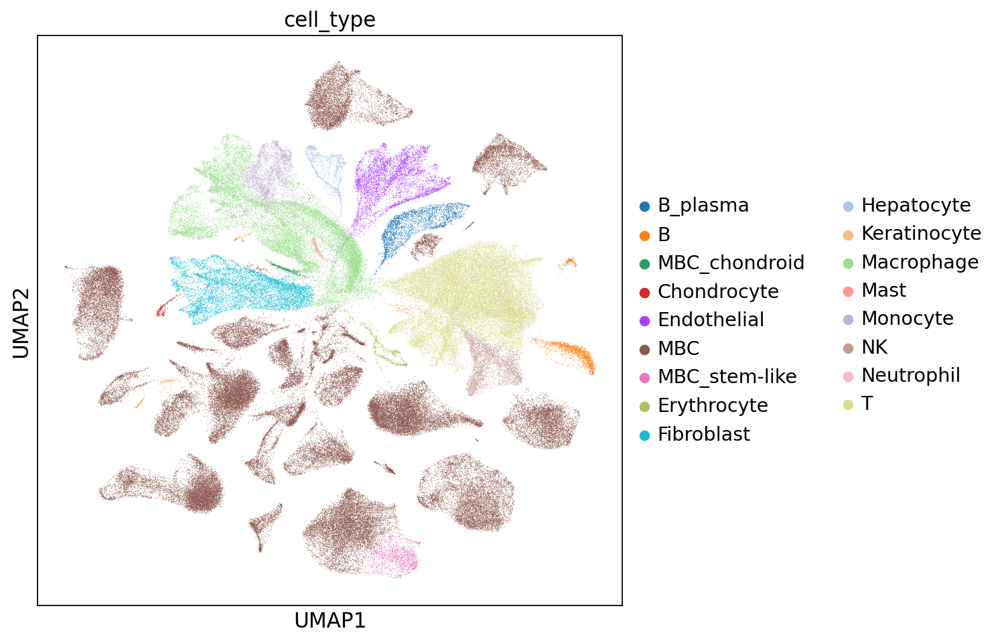

In [133]:
# standard params
plt.rcParams['figure.figsize'] = [7, 7]
sc.pl.umap(adata_sel, color=['cell_type'])

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


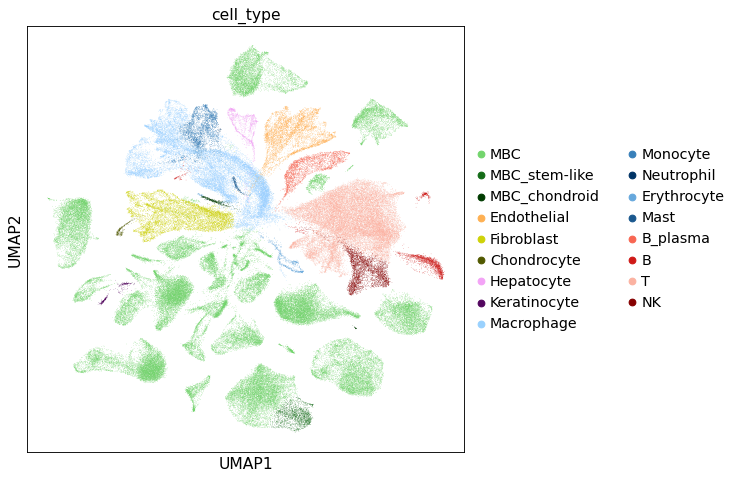

In [10]:
# standard params
sel_colors=colors[colors.index.isin(adata_sel.obs['cell_type'])]
adata_sel.obs['cell_type']=pd.Categorical(adata_sel.obs['cell_type'], categories=sel_colors.index)
plt.rcParams['figure.figsize'] = [7, 7]
fig=sc.pl.umap(adata_sel, color=['cell_type'],palette=sel_colors.values.tolist(),return_fig=True)
fig.savefig(res_dir+cacheName+"_UMAP_ct"+".pdf",bbox_inches="tight")

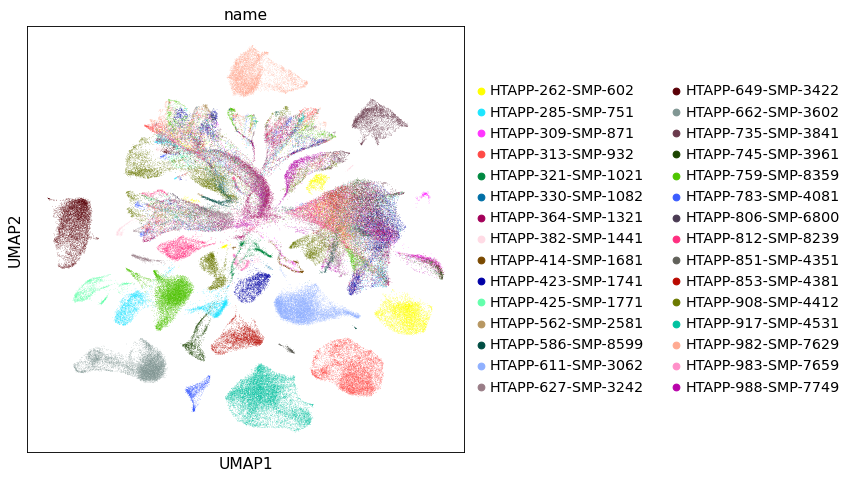

In [34]:
fig=sc.pl.umap(adata_sel, color=['name'],return_fig=True)
fig.savefig(res_dir+cacheName+"_UMAP_name"+".pdf",bbox_inches="tight")

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


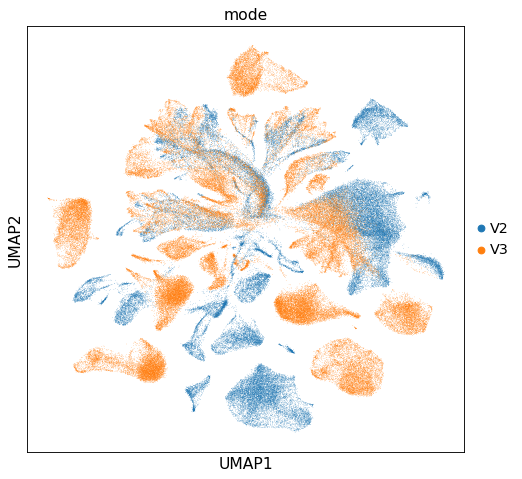

In [35]:
fig=sc.pl.umap(adata_sel, color=['mode'],return_fig=True)
fig.savefig(res_dir+cacheName+"_UMAP_mode"+".pdf",bbox_inches="tight")

In [134]:
adata_sel.write(out_dir+"/"+cacheName+"_selected.h5ad", compression="gzip");

In [5]:
adata_sel=sc.read_h5ad(out_dir+"/"+cacheName+"_selected.h5ad")

#### Check potential doublets

In [19]:
spath=baseDir+"/analysis/00_scrublet/all_scrublet.tsv"
scrub=pd.read_csv(spath,"\t")

In [20]:
scrub.drop(columns=["ident"],inplace=True)

In [21]:
new_obs=adata_sel.obs.merge(scrub,left_on='cell_id', right_on='cellid',how="left")

In [24]:
new_obs.set_index('cellid',inplace=True)
adata_sel.obs=new_obs

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


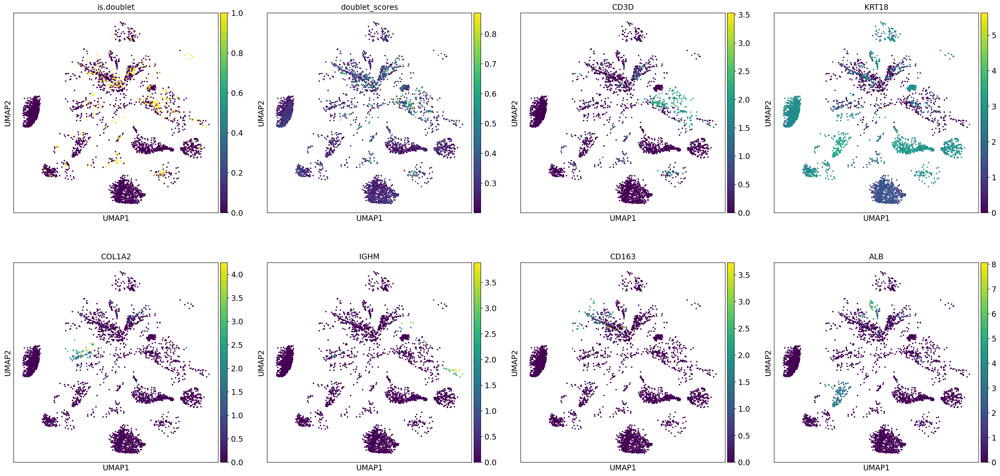

In [40]:
sel_colors=colors[colors.index.isin(adata_sel.obs['cell_type'])]
adata_sel.obs['cell_type']=pd.Categorical(adata_sel.obs['cell_type'], categories=sel_colors.index)
plt.rcParams['figure.figsize'] = [7, 7]
sc.pl.umap(adata_sel[adata_sel.obs['doublet_scores']>0.2], color=['is.doublet','doublet_scores',"CD3D","KRT18","COL1A2","IGHM","CD163","ALB"],palette=sel_colors.values.tolist())

#### DE analysis based on cell_type annotation

In [13]:
sc.tl.rank_genes_groups(adata_sel, 'cell_type', method='t-test_overestim_var',pts=True)

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


In [14]:
de_info=pd.concat([sc.get.rank_genes_groups_df(adata_sel, group=g)[:200].set_index('names').assign(pts=adata_sel.uns['rank_genes_groups']['pts'][g],pts_rest=adata_sel.uns['rank_genes_groups']['pts_rest'][g],type=g).reset_index() for g in adata_sel.obs['cell_type'].unique()])
de_info=de_info.reset_index()
de_info.head()

,index,names,scores,logfoldchanges,pvals,pvals_adj,pct_nz_group,pct_nz_reference,pts,pts_rest,type
0,0,KRT19,787.660095,7.212701,0.0,0.0,0.984692,0.070059,0.984692,0.070059,MBC
1,1,KRT18,705.657227,6.046923,0.0,0.0,0.969071,0.101132,0.969071,0.101132,MBC
2,2,KRT8,694.235901,5.761660,0.0,0.0,0.973820,0.083108,0.973820,0.083108,MBC
3,3,FXYD3,672.816101,6.984408,0.0,0.0,0.922570,0.033688,0.922570,0.033688,MBC
4,4,SPINT2,582.668823,4.644947,0.0,0.0,0.950654,0.149224,0.950654,0.149224,MBC


In [15]:
rest_thres=0.1

In [16]:
markers=de_info[de_info.pts_rest<rest_thres].groupby('type').apply(lambda x: x['names'][:5])
markers=dict(iter(markers.reset_index().groupby('type')['names']))

In [11]:
dedf=pd.DataFrame(de_info[de_info.pts_rest<rest_thres].groupby('type').apply(lambda x: x['names']))
dedf=dict(iter(dedf.reset_index().groupby('type')['names']))

In [12]:
dedf = pd.DataFrame({k: v.reset_index(drop=True) for k, v in dedf.items()})

In [13]:
dedf

,B,B_plasma,Chondrocyte,Endothelial,Erythrocyte,Fibroblast,Hepatocyte,Keratinocyte,MBC,MBC_chondroid,MBC_stem-like,Macrophage,Mast,Monocyte,NK,Neutrophil,T
0,CD79A,IGKC,ASPN,GNG11,HBB,IGFBP7,ALB,PLAT,KRT19,COL11A1,TTYH1,AIF1,CPA3,LST1,KLRD1,CSF3R,CD2
1,IGHM,IGHG3,COL1A2,EGFL7,HBA1,TAGLN,VTN,KRT17,KRT8,SNORC,MIA,TYROBP,TPSAB1,MNDA,KLRF1,MNDA,CD3D
2,CD79B,JCHAIN,AEBP1,HSPG2,HBA2,BGN,AMBP,NNMT,FXYD3,CTHRC1,TFF2,APOC1,HPGDS,FGL2,PRF1,FCGR3B,TRAC
3,TCL1A,IGLC2,COL1A1,IGFBP7,AHSP,MYL9,TTR,MAOB,EPCAM,SCRG1,NOTCH1,FCER1G,MS4A2,C1orf162,TRDC,S100A8,TRBC2
4,MS4A1,IGHG1,LUM,ENG,HBD,DCN,GC,KRT14,CD24,PCOLCE2,UBE2C,C1QA,HPGD,MS4A6A,CD247,LRRK2,CD69
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
161,NaN,NaN,NaN,NaN,NaN,LAMB1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
162,NaN,NaN,NaN,NaN,NaN,PDE1A,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
163,NaN,NaN,NaN,NaN,NaN,CYGB,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
164,NaN,NaN,NaN,NaN,NaN,TUBB6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [14]:
dedf.to_csv(de_dir + "/"+cacheName+"_cell_type_DE.tsv",sep="\t")

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


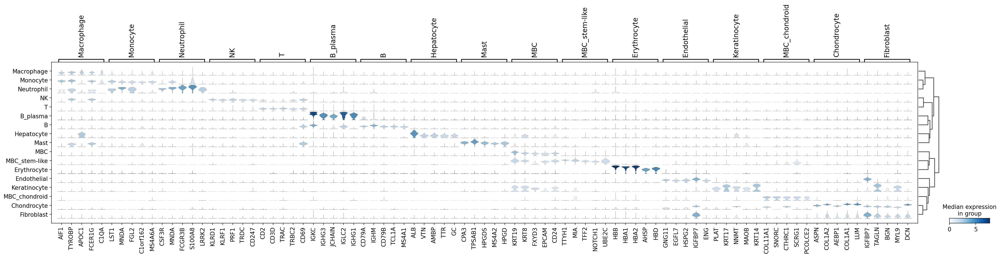

In [15]:
#not reproducible --> precalculate dendrogram based on only marker genes
sc.pl.stacked_violin(adata_sel, markers, groupby='cell_type', dendrogram=True,return_fig=)

In [24]:
sc.tl.dendrogram(adata_sel,groupby='cell_type',var_names=markers,)

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


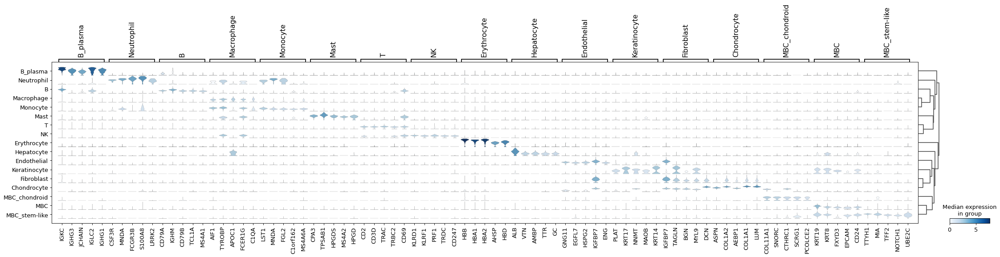

In [26]:
fig=sc.pl.stacked_violin(adata_sel, markers, groupby='cell_type', dendrogram=True,return_fig=True)
fig.savefig(res_dir+cacheName+"_DE"+".pdf",bbox_inches="tight")